# Домашнее задание №1

В данном задании вам предлагаются 3 задачи:
#### 1. Бинарная классификация изображений кошек и собак  (0.4 балла)
Вам потребуется обучить свёрточную нейронную сеть для классификации изображений кошек и собак. Для решения задачи вы зададите архитектуру сети, определите оптимайзер и функцию потерь.  
**Ваша цель:** используя известные вам слои, собрать сеть, дающую $>75\%$ точности классификации на тесте. При обученни нейросети, можете пользоваться вспомогательными функциями *train_model* и *test_model*
#### 2. Обучение классических [ResNet-50](https://pytorch.org/vision/main/models/generated/torchvision.models.resnet50.html) моделей на наборе данных [CIFAR-10](https://www.cs.toronto.edu/~kriz/cifar.html) (0.6 баллов)
В этой задаче вам необходимо обучить несколько моделей ResNet-50 для решения задачи классификации.  
**Ваша цель:** Обучить ResNet-50 "с нуля" на CIFAR-10, инициировав веса модели случаными значениями. Затем провести сравнение обучения на CIFAR-10 предобученной модели и модели, обучаемой с нуля.  
Есть гипотеза, что предобучение на больших наборах данных, таких как [ImageNet](https://www.image-net.org/), помогает при решение других задач, например классификации на малом наборе данных (см. [Transfer Learning](https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html)). Веса предобученной модели содержат некую информацию о встречающихся в природе изображениях, и эта информация может быть использована при решение задач на малом наборе данных. Сравните точности классификации предобученной ResNet-50 модели с моделью обучаемой с нуля. Обучение моделей проведите на подвыборках обучающей выборки CIFAR-10. Возьмите, например, выборку 1%, 10%, 50%, 80% от размера исходной и нарисуйте зависимость точности моделей на тесте от размера обучающей выборки.
#### 3. Поиск точек схода прямых (Vanishing Points)  (0.6 баллов)
В данной задаче вам предстоит использовать детекторы отрезков на изображении для поиска точки схода прямых ([Постановска задачи](https://arxiv.org/pdf/1608.04267.pdf)). Вам будет предложен набор изображений, на которых присутствует ровно одна точка схождения прямых. С помощью детектора отрезков вы можете найти отрезки на изображении. По имеющимся отрезкам можно вычислить точку их пересечения, которая и будет ответом задачи.   
**Ваша цель:** Найти точки схода прямых с помощью детектора отрезков на представленных изображениях.  
Дополнительные баллы (0.2 балла) будут даваться за качественное сравнение (визуально) нейросетевых детекторов отрезков, например [LSDNet](https://github.com/iitpvisionlab/LSDNet), и классических [Hough Transform](https://en.wikipedia.org/wiki/Hough_transform), [LSD: a Line Segment Detector](http://www.ipol.im/pub/art/2012/gjmr-lsd/article.pdf).  
Критерий нахождения точки схода визуальный: нарисуйте найденную вами точку красным, а точку из разметки зелёным. 
Ваш метод должен найти точки схода прямых на как можно большем числе изображений. Дополнительные бонусные баллы получат решения, которые правильно находят точки схода на большем числе изображений.  
Также вы можете попробовать обучить сеть, предсказывающую точки схода напрямую. Возможный подход для обучения модели будет изложен в описании задачи. 


In [1]:
import os

from matplotlib import pyplot as plt
import numpy as np
import time
# from tqdm import tqdm_notebook as tqdm
from tqdm import tqdm
from pathlib import Path
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from torchsummary import summary

class Flatten(nn.Module):
    def forward(self, input):
        return input.view(input.size(0), -1)
    
# используем GPU при наличии
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

device(type='cuda')

## Задача 1. Бинарная классификация изображений (0.4 балла)
<img src="https://www.researchgate.net/profile/Atul-Sharma-77/publication/353247632/figure/fig2/AS:1045582240026626@1626297640509/Classification-of-two-classes-dog-and-cat-using-CNN_W640.jpg" alt="drawing" width="700">  


Вам предлагается обучить свёрточную нейронную сеть для решения задачи бинарной классификации изображений кошек и собак.  
Обучить параметры сети вы можете с помощью градиентного спуска, описанного на лекциях.  
Ниже дан вспомогательный код для загрузки изображений и для обучения модели.

In [2]:
# Запускать только если вы работаете в google collab

# from google.colab import drive
# drive.mount('/content/drive')

In [13]:
### Let's have a cell with global hyperparameters for the CNNs in this notebook

# Path to a directory with image dataset and subfolders for training, validation and final testing
DATA_PATH = 'data' # PATH TO THE DATASET

# Number of threads for data loader
NUM_WORKERS = 8

# Image size: even though image sizes are bigger than 96, we use this to speed up training
SIZE_H = SIZE_W = 96
N_CHANNELS = 3

# Number of classes in the dataset
NUM_CLASSES = 2

# Epochs: number of passes over the training data, we use it this small to reduce training babysitting time
EPOCH_NUM = 30

# Batch size: for batch gradient descent optimization, usually selected as 2**K elements
BATCH_SIZE = 256

# Images mean and std channelwise
image_mean = [0.485, 0.456, 0.406]
image_std  = [0.229, 0.224, 0.225]

# Last layer (embeddings) size for CNN models
EMBEDDING_SIZE = 256

### Загрузка данных

In [14]:
# !wget -nc https://www.dropbox.com/s/gqdo90vhli893e0/data.zip
# !unzip -n data.zip -d data
# !rm data.zip

### Определение преобразований, применяемых к изображениям

In [15]:
transformer = transforms.Compose([
    transforms.Resize((SIZE_H, SIZE_W)),        # scaling images to fixed size
    transforms.ToTensor(),                      # converting to tensors
    transforms.Normalize(image_mean, image_std) # normalize image data per-channel
])

In [16]:
train_dataset = torchvision.datasets.ImageFolder(os.path.join(DATA_PATH, 'train_11k'), transform=transformer)
val_dataset   = torchvision.datasets.ImageFolder(os.path.join(DATA_PATH, 'val'), transform=transformer)
test_dataset  = torchvision.datasets.ImageFolder(os.path.join(DATA_PATH, 'test_labeled'), transform=transformer)

n_train, n_val, n_test = len(train_dataset), len(val_dataset), len(test_dataset)

In [17]:
train_loader = torch.utils.data.DataLoader(
    train_dataset, 
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS
)

val_loader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS
)

test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS
)

In [18]:
class Flatten(nn.Module):
    def forward(self, input):
        return input.view(input.size(0), -1)

### Функция обучения нейронной сети

In [19]:
def train_model(model, train_loader, val_loader, loss_fn, opt, n_epochs):
    ''' model: нейросеть для обучения,  
    train_loader, val_loader: загрузчики данных
    loss_fn: целевая метрика (которую будем оптимизировать)
    opt: оптимизатор (обновляет веса нейросети)
    n_epochs: кол-во эпох, полных проходов датасета
    '''
    train_loss = []
    val_accuracy = []
    
    for epoch in range(n_epochs):
        start_time = time.time()

        model.train(True) # enable dropout / batch_norm training behavior
        for X_batch, y_batch in train_loader:
            # move data to target device
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            # train on batch: compute loss, calc grads, perform optimizer step and zero the grads
            opt.zero_grad()
            predictions = model(X_batch)
            loss = loss_fn(predictions, y_batch)
            loss.backward()
            # torch.nn.utils.clip_grad_norm_(model.parameters(), 5)
            opt.step()
            train_loss.append(loss.item())

        model.train(False) # disable dropout / use averages for batch_norm
        for X_batch, y_batch in val_loader:
            # move data to target device
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            # compute logits
            logits = model(X_batch)
            y_pred = logits.max(1)[1].data
            val_accuracy.append(np.mean( (y_batch.cpu() == y_pred.cpu()).numpy() ))

        # print the results for this epoch:
        print(f'Epoch {epoch + 1}/{n_epochs}:\t time {time.time() - start_time:.3f}s,', end="\t")

        train_loss_value = np.mean(train_loss[-n_train // BATCH_SIZE :])
        val_accuracy_value = np.mean(val_accuracy[-n_val // BATCH_SIZE :]) * 100
        
        print(f"training loss (in-iteration): {train_loss_value:.6f},\t  validation accuracy: {val_accuracy_value:.2f} %")

    return train_loss, val_accuracy

### Определение и обучение нейронной сети

### First step

**conv-pool-conv-pool-dense-dense!**

Создайте мини-сверточную нейронную сеть со следующей структурой:
* Входной слой
* 3 классических сверточных блока `convolution->relu->pool`: 
  * свертка 3x3 с 128 фильтрами и функцией активации _ReLU_
  * 2x2 пулинг (или поставьте для предыдущей свертки страйд = 3)
 * Flatten
* 30% Dropout 
* Линейный слой с 256 нейронами и функцией активации _ReLU_
* 30% dropout
* Выходной линейный слой.

Вы также можете добавить [BatchNorm](https://pytorch.org/docs/stable/generated/torch.nn.BatchNorm2d.html) слой, который может значительно увеличить скорость сходимости модели

__Convolutional layers__ в торче создаются как любой другой слой, но у него есть особые параметры:

__`...`__

__`model.add_module('conv1', nn.Conv2d(in_channels=3, out_channels=128, kernel_size=3)) # свёртка`__

__`model.add_module('pool1', nn.MaxPool2d(2)) # max pooling 2 на 2`__

__`...`__


Когда вы закончите создание нейросети, обучите её с оптимайзером __Adam__ с LR = 3e-4 (Константа Карпатого)

Если всё верно, вы должны получить минимум __75%__ точности на валидации.

Количество каналов должно быть в порядке количества class_labels

Вы можете поставить stride=2 для Conv2d слоя чтобы увеличить скорость обучения, но помните про размерности

In [20]:
model_cnn = nn.Sequential()

model_cnn.add_module('conv_1', nn.Conv2d(3, 64, 3, stride=2, padding=1)) # 48 x 48 x 64
# Место для вашего кода: CONV->POOL->CONV-POOL->... as many as you wish
model_cnn.add_module('bn_1', nn.BatchNorm2d(64))
model_cnn.add_module('relu_1', nn.ReLU(inplace=True))
model_cnn.add_module('pool_1', nn.MaxPool2d(2)) # 24 x 24 x 64
model_cnn.add_module('conv_2', nn.Conv2d(64, 64, 3, padding=1)) # 24 x 24 x 64
# model_cnn.add_module('bn_2', nn.BatchNorm2d(64))
model_cnn.add_module('relu_2', nn.ReLU(inplace=True))
model_cnn.add_module('pool_2', nn.MaxPool2d(2)) # 12 x 12 x 64
model_cnn.add_module('conv_3', nn.Conv2d(64, 32, 3, stride=1, padding=1)) # 12 x 12 x 32
model_cnn.add_module('bn_3', nn.BatchNorm2d(32))
model_cnn.add_module('relu_2', nn.ReLU(inplace=True))
model_cnn.add_module('pool_3', nn.MaxPool2d(2)) # 6 x 6 x 32

# End of your code here
# global average pooling
model_cnn.add_module('gap_5', nn.AdaptiveAvgPool2d((2, 2))) # 2 x 2 x 32
# dropout for regularization
model_cnn.add_module('dropout_5', nn.Dropout(0.3))
# "flatten" the data
model_cnn.add_module('flat', Flatten())
# last fully-connected layer, used to create embedding vectors
model_cnn.add_module('fc_6', nn.Linear(128, EMBEDDING_SIZE))
model_cnn.add_module('relu_6', nn.ReLU())
model_cnn.add_module('bn_6', nn.BatchNorm1d(EMBEDDING_SIZE))

model_cnn.add_module('dropout_6', nn.Dropout(0.3))

# logits for NUM_CLASSES=2 classes
model_cnn.add_module('fc_logits', nn.Linear(EMBEDDING_SIZE, NUM_CLASSES))
model_cnn.add_module('fc_preds', nn.Sigmoid())

# move model to computing device
model_cnn = model_cnn.to(device)

In [21]:
train_dataset[0][0].shape

torch.Size([3, 96, 96])

In [22]:
summary(model_cnn, train_dataset[0][0].shape);

Layer (type:depth-idx)                   Output Shape              Param #
├─Conv2d: 1-1                            [-1, 64, 48, 48]          1,792
├─BatchNorm2d: 1-2                       [-1, 64, 48, 48]          128
├─ReLU: 1-3                              [-1, 64, 48, 48]          --
├─MaxPool2d: 1-4                         [-1, 64, 24, 24]          --
├─Conv2d: 1-5                            [-1, 64, 24, 24]          36,928
├─ReLU: 1-6                              [-1, 64, 24, 24]          --
├─MaxPool2d: 1-7                         [-1, 64, 12, 12]          --
├─Conv2d: 1-8                            [-1, 32, 12, 12]          18,464
├─BatchNorm2d: 1-9                       [-1, 32, 12, 12]          64
├─MaxPool2d: 1-10                        [-1, 32, 6, 6]            --
├─AdaptiveAvgPool2d: 1-11                [-1, 32, 2, 2]            --
├─Dropout: 1-12                          [-1, 32, 2, 2]            --
├─Flatten: 1-13                          [-1, 128]                 --
├─L

In [22]:
#Оптимайзер
opt = torch.optim.Adam(model_cnn.parameters(), lr=3e-4)

#Функция потерь (Лосс функция)
loss_fn = torch.nn.CrossEntropyLoss() 
# loss_fn = torch.nn.MSELoss() 

#Число эпох
n_epochs = EPOCH_NUM 

In [19]:
opt.zero_grad()
train_loss, val_accuracy = train_model( model_cnn,
                                        train_loader,
                                        val_loader,
                                        loss_fn,
                                        opt,
                                        n_epochs)

Epoch 1/30:	 time 23.257s,	training loss (in-iteration): 0.639738,	  validation accuracy: 61.87 %
Epoch 2/30:	 time 22.446s,	training loss (in-iteration): 0.587767,	  validation accuracy: 69.47 %
Epoch 3/30:	 time 22.195s,	training loss (in-iteration): 0.551207,	  validation accuracy: 66.09 %
Epoch 4/30:	 time 22.831s,	training loss (in-iteration): 0.526955,	  validation accuracy: 63.72 %
Epoch 5/30:	 time 22.488s,	training loss (in-iteration): 0.510090,	  validation accuracy: 71.66 %
Epoch 6/30:	 time 22.180s,	training loss (in-iteration): 0.506105,	  validation accuracy: 74.45 %
Epoch 7/30:	 time 22.553s,	training loss (in-iteration): 0.492950,	  validation accuracy: 76.60 %
Epoch 8/30:	 time 22.719s,	training loss (in-iteration): 0.488099,	  validation accuracy: 73.64 %
Epoch 9/30:	 time 22.541s,	training loss (in-iteration): 0.477567,	  validation accuracy: 75.17 %
Epoch 10/30:	 time 22.292s,	training loss (in-iteration): 0.480563,	  validation accuracy: 76.64 %
Epoch 11/30:	 time 

In [11]:
def test_model(model, test_loader, subset='test'):
    model.train(False) # disable dropout / use averages for batch_norm
    test_batch_acc = []
    for X_batch, y_batch in test_loader:
        logits = model(X_batch.to(device))
        y_pred = logits.max(1)[1].data
        test_batch_acc.append(np.mean( (y_batch.cpu() == y_pred.cpu()).numpy() ))

    test_accuracy = np.mean(test_batch_acc)
    
    print("Results:")
    print(f"  {subset} accuracy:\t\t{test_accuracy * 100:.2f} %")
    if test_accuracy > 0.9:
        print("Amazing!")
    elif test_accuracy > 0.7:
        print("Good!")
    else:
        print("We need more magic! Follow instructons above")
    return test_accuracy

In [21]:
val_accuracy = test_model(model_cnn, val_loader, subset='val')
test_accuracy = test_model(model_cnn, test_loader, subset='test')

Results:
  val accuracy:		82.22 %
Good!
Results:
  test accuracy:		83.91 %
Good!


## Задача 2. Классификация с помощью ResNet50 (0.6 баллов)  
<img src="https://production-media.paperswithcode.com/datasets/4fdf2b82-2bc3-4f97-ba51-400322b228b1.png" alt="drawing" width="400">  

Вам предлагается обучить популярную свёрточную нейронную сеть [ResNet-50](https://pytorch.org/vision/main/models/generated/torchvision.models.resnet50.html)  для решения задачи классификации на наборе данных [CIFAR-10](https://www.cs.toronto.edu/~kriz/cifar.html).  
Выполнение задачи состоит из следующих шагов:
1. Обучение ResNet-50 на CIFAR-10 с нуля и измерение точности классификации на тестовой выборке
2. Дообучение предобученной на [ImageNet](https://www.image-net.org/) ResNet-50 (pretrained=True), сравнение точности с моделью из первого пункта
3. Исследование эффекта Transfer learning. Обучите модели из пунктов 1-2 на подвыборке обучающей выборки CIFAR-10, сохраняя тестовый набор неизменным.
Так как в весах предобученной на ImageNet модели содержится информация о натуральных избражениях, то ей достаточно меньшего обучающего набора (чем для модели, обучаемой с нуля), чтобы получить высокую точность на тесте. Проверте эту гипотезу для размеров обучающей выборки размера 1%, 10%, 50%, 80% от размера исходной. Нарисуйте график, где по оси X отложен размер обучающей выборки, а по оси Y точность на тесте предобученной модели и обученной с нуля. Помогает ли предобучение модели?

### Загрузка данных

In [2]:
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import DataLoader, Subset, SubsetRandomSampler

NUM_WORKERS = 8

In [3]:
def get_transform(train):
    if train:
        transform = transforms.Compose(
            [
                transforms.Resize((32, 32)),
                transforms.RandomHorizontalFlip(p=0.5),
                transforms.ToTensor(),
                transforms.Normalize(
                    [0.4914, 0.4822, 0.4465], [0.2023, 0.1994, 0.2010]
                ),
            ]
        )
    else:
        transform = transforms.Compose(
            [
                transforms.ToTensor(),
                transforms.Normalize(
                    [0.4914, 0.4822, 0.4465], [0.2023, 0.1994, 0.2010]
                ),
            ]
        )
    return transform

DATA_PATH = "cifar_data"
BATCH_SIZE = 128

train_dset = torchvision.datasets.CIFAR10(
    DATA_PATH,
    train=True,
    transform=get_transform(train=True),
    download=True,
)
test_dset = torchvision.datasets.CIFAR10(
    DATA_PATH,
    train=False,
    transform=get_transform(train=False),
    download=True,
)

train_loader = DataLoader(
    train_dset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    drop_last=True,
)

val_loader = DataLoader(
    test_dset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    drop_last=True,
)

Files already downloaded and verified
Files already downloaded and verified


### Загрузка модели

Так как разрешение изображений в наборе данных [CIFAR-10](https://www.cs.toronto.edu/~kriz/cifar.html), меньше чем в на наборе данных [ImageNet](https://www.image-net.org/) (целевой набор данных для разработчиков ResNet-50), мы заменим первый свёрточный слой с ядром $(7\times 7)$ и страйдом $2$, на свёрточный слой с ядром размера $(3\times3)$ и страйдом $1$  
Также мы удалим первый maxpolling слой

Определяю свою функцию для получения загрузчика выборки данных с заданной пропорцией  

И свою функцию загрузки модели с заданными параметрами

In [4]:
def get_subset_loader(dataset, fract=0.01, batch_size=BATCH_SIZE):
    '''get a subset of the training data loader with a given fraction of data'''
    if fract > 1.0 or fract <= 0.0:
        raise ValueError("fract must be less than 1.0 and greater than 0.0")
    return DataLoader(
        dataset,
        batch_size=batch_size,
        num_workers=NUM_WORKERS,
        drop_last=True,
        sampler=SubsetRandomSampler(list(range(
            int(np.ceil(fract*len(dataset)/batch_size)*batch_size)))
        ))

def get_resnet50_cifar_model(pretrained=False):
    resnet50 = torchvision.models.resnet50(pretrained=pretrained)#.to(device)

    new_modules = [
        nn.Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(inplace=True),
    ] + list(resnet50.children())[4:-1] + [Flatten(), nn.Sequential(nn.Linear(2048, 10))]
    return torch.nn.Sequential(*new_modules) #.to(device)
    
# train_subset_loader = get_train_subset_loader(train_dset, 0.01)
# for data, targets in train_subset_loader:
#     print(data.shape, targets.shape)

# resnet50_cifar = get_resnet50_cifar_model(pretrained=True)
# summary(resnet50_cifar, (3, 32, 32));

### Обучение и сравнение моделей

Реализую функцию обучения модели и тестирования  
Функции будут возврящать лосс и точность на эпохе

In [5]:
# Место для вашего кода
EPOCHS = 25

def epoch_train(model, device, train_loader, criterion, optimizer, scheduler):
    '''train model for one epoch'''
    pbar = tqdm(train_loader)
    pbar.set_description(f"    Epoch {scheduler.state_dict()['last_epoch']+1}/{EPOCHS} Train")
    
    # train mode
    model.train()
    
    run_loss = 0.0
    run_corrects = 0
    processed_size = 0
    
    for inputs, labels in pbar:
        # learning part
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        _, preds = torch.max(outputs, 1)
        
        # metrics part
        run_loss += loss.item() * inputs.size(0)
        run_corrects += torch.sum(preds == labels.data)
        processed_size += inputs.size(0)
        
        # progress bar part
        pbar.set_postfix({
            'Loss' : f"{run_loss / processed_size:.4f}",
            'Acc' :  f"{run_corrects.double() / processed_size:.3%}"},
        )
        
    scheduler.step()
    
    epoch_loss = run_loss / processed_size
    epoch_acc = run_corrects.double().item() / processed_size
    return epoch_loss, epoch_acc


# test model on one epoch with test_loader
def test_model(model, device, test_loader, criterion):   
    '''validate model for one epoch'''
    pbar = tqdm(test_loader)
    pbar.set_description(f"                 Val")
    
    # eval mode
    model.eval()
    
    run_loss = 0.0
    run_corrects = 0
    processed_size = 0
    
    for inputs, labels in pbar:
        # inference part
        inputs, labels = inputs.to(device), labels.to(device)
        
        with torch.no_grad():
            outputs = model(inputs)
            loss = criterion(outputs, labels)
        _, preds = torch.max(outputs, 1)
        
        # metrics part
        run_loss += loss.item() * inputs.size(0)
        run_corrects += torch.sum(preds == labels.data)
        processed_size += inputs.size(0)
        
        # progress bar part
        pbar.set_postfix({
            'Loss' : f"{run_loss / processed_size:.4f}",
            'Acc' :  f"{run_corrects.double() / processed_size:.3%}"},
        )
    
    mean_loss = run_loss / processed_size
    mean_acc = run_corrects.double().item() / processed_size
    return mean_loss, mean_acc


# train model on all epochs    
def train_model(model, device, train_loader, val_loader, 
                criterion, optimizer, scheduler, num_epochs=EPOCHS):
    train_losses = []
    train_accs = []
    val_losses = []
    val_accs = []
    
    for epoch in range(num_epochs):
        train_loss, train_acc = epoch_train(model, device, train_loader, criterion, optimizer, scheduler)
        val_loss, val_acc = test_model(model, device, val_loader, criterion)
        
        train_losses.append(train_loss)
        train_accs.append(train_acc)
        val_losses.append(val_loss)
        val_accs.append(val_acc)
    
    return train_losses, train_accs, val_losses, val_accs

Обучим по циклу модели с нуля и предобученную на ImageNet  
Результаты будут записаны в словарь

In [6]:
import gc

stat_dict = {"Pretrained": {}, "Trained from scratch": {}}

train_fractions = [.01, .1, .5, .8]
val_fractions = [.1, .5, .5, .5]

for train_fraction, val_fraction in zip(train_fractions, val_fractions):    
    train_subset_loader = get_subset_loader(train_dset, train_fraction)
    val_subset_loader = get_subset_loader(test_dset, val_fraction)

    for pretrained in [True, False]:
        model_info = "Pretrained" if pretrained else "Trained from scratch"
        print(f"{train_fraction:.0%} train dataset fraction. {model_info} Resnet50")
        
        resnet50_cifar = get_resnet50_cifar_model(pretrained=pretrained).to(device)

        criterion = nn.CrossEntropyLoss()
        optimizer = optim.SGD(resnet50_cifar.parameters(), lr=0.001, momentum=0.9)
        scheduler = StepLR(optimizer, step_size=10, gamma=0.1)

        train_losses, train_accs, val_losses, val_accs = train_model(
            resnet50_cifar, device, 
            train_subset_loader, val_subset_loader, 
            criterion, optimizer, scheduler, 
            num_epochs=EPOCHS
        )

        print("    Test on full test dataset")
        test_loss, test_acc = test_model(resnet50_cifar, device, val_loader, criterion)
        print(f"    {model_info} Resnet50: Loss = {test_loss:.5f}, Acc = {test_acc:.4%}\n")
        
        train_frac = int(train_fraction * 100)
        stat_dict[model_info][train_frac] = {}
        stat_dict[model_info][train_frac]['train loss'] = train_losses
        stat_dict[model_info][train_frac]['train acc'] = train_accs
        stat_dict[model_info][train_frac]['val loss'] = val_losses
        stat_dict[model_info][train_frac]['val acc'] = val_accs
        stat_dict[model_info][train_frac]['test loss'] = test_loss
        stat_dict[model_info][train_frac]['test acc'] = test_acc 
        
        del resnet50_cifar
        torch.cuda.empty_cache() 
        gc.collect()
    print("\n")

1% train dataset fraction. Pretrained Resnet50


                 Val: 100%|██████████| 8/8 [00:13<00:00,  1.65s/it, Loss=1.8581, Acc=38.477%]


    Test on full test dataset


                 Val: 100%|██████████| 78/78 [00:18<00:00,  4.25it/s, Loss=1.8692, Acc=36.068%]


Pretrained Resnet50: Loss = 1.86921, Acc = 36.0677%

1% train dataset fraction. Trained from scratch Resnet50


                 Val: 100%|██████████| 8/8 [00:12<00:00,  1.61s/it, Loss=2.3142, Acc=16.699%]


    Test on full test dataset


                 Val: 100%|██████████| 78/78 [00:18<00:00,  4.25it/s, Loss=2.2651, Acc=17.698%]


Trained from scratch Resnet50: Loss = 2.26513, Acc = 17.6983%



10% train dataset fraction. Pretrained Resnet50


                 Val: 100%|██████████| 40/40 [00:15<00:00,  2.57it/s, Loss=0.9546, Acc=69.434%]


    Test on full test dataset


                 Val: 100%|██████████| 78/78 [00:15<00:00,  5.13it/s, Loss=0.9428, Acc=69.942%]


Pretrained Resnet50: Loss = 0.94279, Acc = 69.9419%

10% train dataset fraction. Trained from scratch Resnet50


                 Val: 100%|██████████| 40/40 [00:15<00:00,  2.61it/s, Loss=1.7578, Acc=34.766%]


    Test on full test dataset


                 Val: 100%|██████████| 78/78 [00:17<00:00,  4.37it/s, Loss=1.7654, Acc=34.075%]


Trained from scratch Resnet50: Loss = 1.76538, Acc = 34.0745%



50% train dataset fraction. Pretrained Resnet50


                 Val: 100%|██████████| 40/40 [00:11<00:00,  3.37it/s, Loss=0.3310, Acc=90.449%]


    Test on full test dataset


                 Val: 100%|██████████| 78/78 [00:14<00:00,  5.34it/s, Loss=0.3376, Acc=90.475%]


Pretrained Resnet50: Loss = 0.33763, Acc = 90.4748%

50% train dataset fraction. Trained from scratch Resnet50


                 Val: 100%|██████████| 40/40 [00:15<00:00,  2.63it/s, Loss=1.2596, Acc=54.688%]


    Test on full test dataset


                 Val: 100%|██████████| 78/78 [00:18<00:00,  4.27it/s, Loss=1.2704, Acc=53.906%]


Trained from scratch Resnet50: Loss = 1.27038, Acc = 53.9062%



80% train dataset fraction. Pretrained Resnet50


                 Val: 100%|██████████| 40/40 [00:12<00:00,  3.33it/s, Loss=0.2593, Acc=93.086%]


    Test on full test dataset


                 Val: 100%|██████████| 78/78 [00:14<00:00,  5.32it/s, Loss=0.2637, Acc=93.259%]


Pretrained Resnet50: Loss = 0.26368, Acc = 93.2592%

80% train dataset fraction. Trained from scratch Resnet50


                 Val: 100%|██████████| 40/40 [00:12<00:00,  3.24it/s, Loss=1.0794, Acc=61.563%]


    Test on full test dataset


                 Val: 100%|██████████| 78/78 [00:15<00:00,  5.17it/s, Loss=1.0899, Acc=60.777%]

Trained from scratch Resnet50: Loss = 1.08993, Acc = 60.7772%





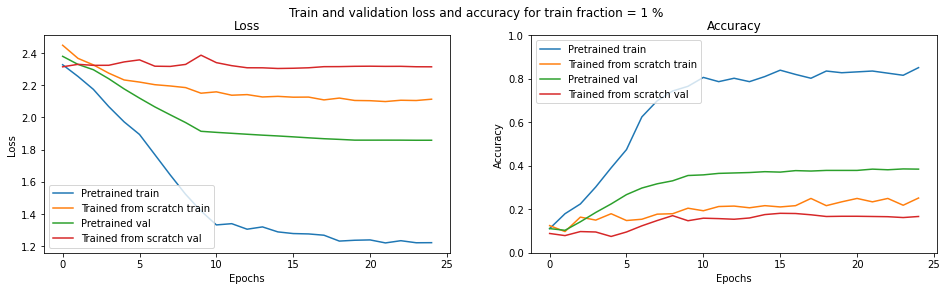

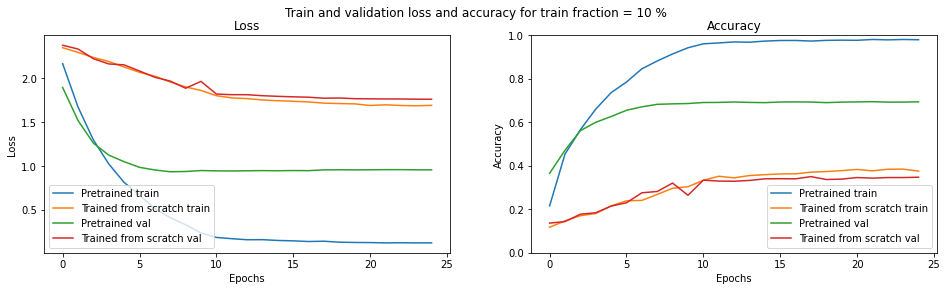

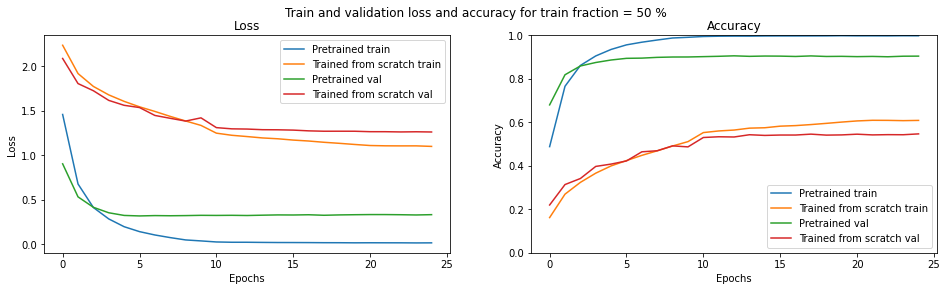

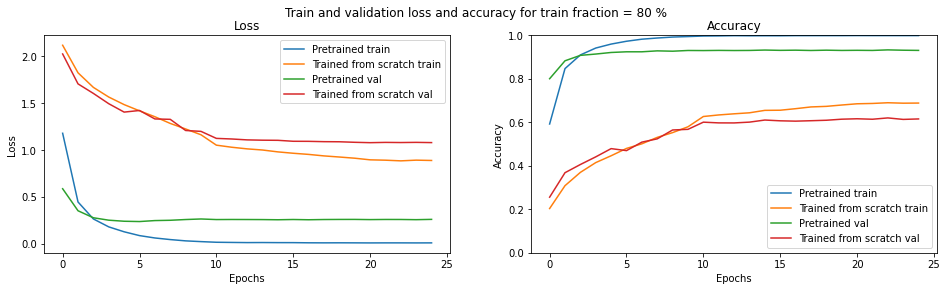

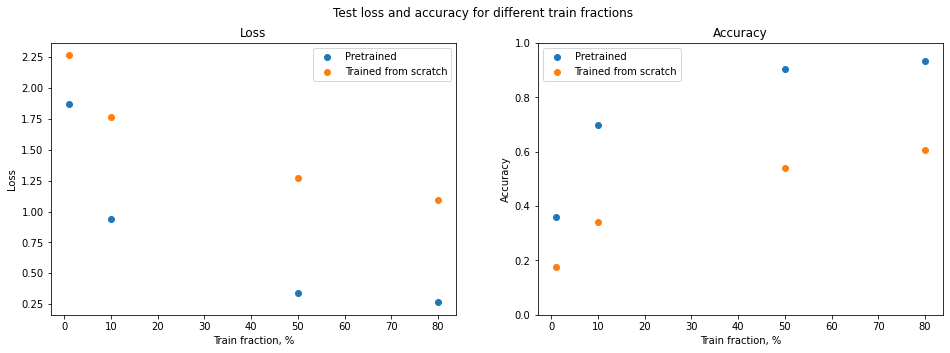

In [7]:
# Plotting the results of the experiment from stat_dict
# Train and validation loss on one plot and train and validation accuracy on another
train_fracs = [1, 10, 50, 80]
losses_pretrained = []
losses_from_scratch = []
accs_pretrained = []
acc_from_scratch = []

# plots for train and validation loss and accuracy
dataset_types = ['train', 'val']
for train_frac in train_fracs:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 4))
    fig.suptitle(f"Train and validation loss and accuracy for train fraction = {train_frac} %")
    ax1.set(xlabel='Epochs', ylabel='Loss', title=f"Loss")
    ax2.set(xlabel='Epochs', ylabel='Accuracy', title=f"Accuracy", ylim=(0, 1))
    
    legend = []
    for dtype in dataset_types:
        for model_info in stat_dict:
            ax1.plot(stat_dict[model_info][train_frac][f'{dtype} loss'], label=f"{model_info} train frac = {train_frac}")
            ax2.plot(stat_dict[model_info][train_frac][f'{dtype} acc'], label=f"{model_info} train frac = {train_frac}")
            legend.append(f"{model_info} {dtype}")
    ax1.legend(legend)
    ax2.legend(legend)
    plt.show()
    
    losses_pretrained.append(stat_dict["Pretrained"][train_frac]['test loss'])
    losses_from_scratch.append(stat_dict["Trained from scratch"][train_frac]['test loss'])
    accs_pretrained.append(stat_dict["Pretrained"][train_frac]['test acc'])
    acc_from_scratch.append(stat_dict["Trained from scratch"][train_frac]['test acc'])
    
# plots for test loss and accuracy 
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle(f"Test loss and accuracy for different train fractions")
ax1.set(xlabel='Train fraction, %', ylabel='Loss', title=f"Loss")
ax2.set(xlabel='Train fraction, %', ylabel='Accuracy', title=f"Accuracy", ylim=(0, 1))
ax1.plot(train_fracs, losses_pretrained, 'o')
ax1.plot(train_fracs, losses_from_scratch, 'o')
ax2.plot(train_fracs, accs_pretrained, 'o')
ax2.plot(train_fracs, acc_from_scratch, 'o')
ax1.legend(["Pretrained", "Trained from scratch"])
ax2.legend(["Pretrained", "Trained from scratch"])
plt.show()

**Видим, что гипотеза о том, что предобученная модель будет обучаться быстрее, чем модель с нуля, подтвердилась**  
Предобученная модель показывает лучшие результаты на тестовой выборке  

Можно заметить, что при обучении на меньшей части тренировочного датасета у предобученной модели огромная разница между тренировочным и валидационным лоссом. Это говорит о том, что при недостаточном количестве данных модель склонна к переобучению

## Задача 3. Поиск точек схода прямых (Vanishing Points) (0.6 баллов)

<img src="https://zihan-z.github.io/projects/vpdetection/teaser.jpg" alt="drawing" width="800">

Вам предлагается решить задачу поиска точки схода прямых с помощью детектирования отрезков. Также вы можете попробовать нейросетевой способ, где точка схода предсказывается на прямую с помощью нейросети.

#### **Способ решения задачи, основанный на детектировании отрезков:**
В данной задаче вам предстоит использовать детекторы отрезков на изображении для поиска точки схода прямых ([Постановска задачи](https://arxiv.org/pdf/1608.04267.pdf)). Вам будет предложен набор изображений, на которых присутствует ровно одна точка схождения прямых. С помощью детектора отрезков вы можете найти отрезки на изображении. По имеющимся отрезкам можно вычислить точку их пересечения, которая и будет ответом задачи.   
**Ваша цель:** Найти точки схода прямых с помощью детектора отрезков на представленных изображениях.  
Дополнительные баллы (0.2 балла) будут даваться за качественное сравнение (визуально) нейросетевых детекторов отрезков, например [LSDNet](https://github.com/iitpvisionlab/LSDNet), и классических [Hough Transform](https://en.wikipedia.org/wiki/Hough_transform), [LSD: a Line Segment Detector](http://www.ipol.im/pub/art/2012/gjmr-lsd/article.pdf).  
Критерий нахождения точки схода визуальный: нарисуйте найденную вами точку красным, а точку из разметки зелёным. 
Ваш метод должен найти точки схода прямых на как можно большем числе изображений предоставленного ниже набора *vp_images*. Дополнительные бонусные баллы получат решения, которые правильно находят точки схода на большем числе изображений.

In [2]:
# !wget -nc https://dl.dropboxusercontent.com/s/dwy2mo6jd52r5rh/vp_images.zip
# !unzip vp_images.zip

import pandas as pd
import cv2
from PIL import Image
import numpy as np

def view(img):
    if img.dtype != np.uint8:
        img = (img * 255).astype(np.uint8)
    return Image.fromarray(img)

IMGS_PATH = 'vp_images'

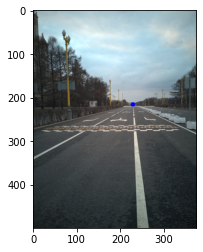

In [3]:
vanish_points_df = pd.read_csv(f'{IMGS_PATH}/vanish_points.csv', sep=';')
img_names = vanish_points_df['file'].to_list()

image_name = '1_SI.png'
image = cv2.imread(f'{IMGS_PATH}/{image_name}')

ind = img_names.index(image_name)
point = (vanish_points_df.iloc[ind].x, vanish_points_df.iloc[ind].y)
image = cv2.circle(image, point, radius=5, color=(255, 0, 0), thickness=-1)

plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB));

Определим функции для детектирования  

**Детектирование линий**
- Сначала преобразую цветное входное изображение в серое  
- Затем заблюриваю изображение с помощью функции GaussianBlur, чтобы удалить шум в изображении, который приводит к появлению неровных краев, которые не нужны и могут привести к ложным срабатываниям.
- Затем нахожу на зображение грани с помощью функции Canny c пороговыми значениями `canny_thr_lower`, `canny_thr_upper`. 
- Использую вероятностоное преобразование Хафа с порогом `hough_thr`
- После фильтрую найденные линии 
    - по углу, отбрасывая почти вертикальные и почти горизонтальные с указанным порогом `reject_degree_thr`
    - по длине, оставляя самые длинные
- Записываю координаты концов отрезка линии, коэффициенты уравнения прямой, длину линии

**Детектирование точек пересечения**
- Для каждой пары детектированных линий нахожу их точку пересечения,  
- Затем для этой точки определяю расстояние до каждой детектированной линии,  
- Выбираю точку пересечения, расстояние от которой до других минимально

In [4]:
def detect_lines(image, canny_thr_lower=40, canny_thr_upper=250, 
                 reject_degree_thr=2.0, max_lines_cnt=10,
                 gaussian_blur = True, hough_thr=100):
    ''' detect lines in the image using Hough transform
    
    returns list where each line is list:
    ```
        [x1, y1, x2, y2, k, b, l]
    ```
        - `x1, y1, x2, y2` : coordinates of line points   
        - `k, b` : coeffs of line equation y = k*x + b  
        - `l` - line lengh
    
    returns None if no lines detected
    '''
    
    edge = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    if gaussian_blur:
        edge = cv2.GaussianBlur(edge, (5, 5), 1)
    edge = cv2.Canny(edge, canny_thr_lower, canny_thr_upper)
    
    lines = cv2.HoughLinesP(edge, 1, np.pi/180, hough_thr, 10, 10)

    if lines is None:
        return None
    
    filtered_lines = []
    for x1, y1, x2, y2 in lines[:,0]: # Iterating over each line
        # find line equation, first slope ( k )
        if x1 != x2:
            k = (y2 - y1) / (x2 - x1)
        else:
            k = 1e8
        b = y2 - k*x2 # b = y - kx 
        # theta ( -90 : +90 )
        theta = np.rad2deg(np.arctan(k))
        # reject almost horizontal or vertical lines
        if reject_degree_thr <= abs(theta) <= (90 - reject_degree_thr):
            # length of the line
            l = np.sqrt( (y2 - y1)**2 + (x2 - x1)**2 )
            filtered_lines.append([x1, y1, x2, y2, k, b, l])
            
        # Taking only the longest lines
        filtered_lines = sorted(filtered_lines, key=lambda x: x[-1], reverse=True)
        filtered_lines = filtered_lines[:max_lines_cnt]
    return filtered_lines

def detect_vanish_point(lines):
    '''detecting coords of single vanishing point
    '''
    vanish_pnt = None # Coordinates of the vanishing point
    min_error = 1e10  # Minimum error found (initially large value)
    for i in range(len(lines)): # Iterating over lines and taking 2 at once
        for j in range(i+1, len(lines)):
            # Reading k and b values
            k1, b1 = lines[i][4:6]
            k2, b2 = lines[j][4:6]
            # If lines are not parallel
            if k1 != k2:
                # intersection point
                x0 = (b1 - b2) / (k2 - k1)
                y0 = k1 * x0 + b1
                err = 0 # initial error of this point
                # Iterating over all lines for measure distance to them
                for m in range(len(lines)):
                    k, b = lines[m][4:6]
                    # perpendicular line
                    k_ = (-1 / k)
                    b_ = y0 - k_ * x0
                    # intersection of line and perpendicular
                    x_ = (b - b_) / (k_ - k)
                    y_ = k_ * x_ + b_
                    # distance between (x0, y0) and (x_, y_)
                    l = np.sqrt((y_ - y0)**2 + (x_ - x0)**2)
                    err += l**2 # Adding to error value
                err = np.sqrt(err) # summary of error for point x0, y0
                # Comparing with minimum error value till now
                # Updating minimum error value and vanishing point coordinates
                if min_error > err:
                    min_error = err
                    vanish_pnt = (int(x0), int(y0))
    return vanish_pnt        

Столкнулся с проблемой, что при изпользовании заблюривания и высоком пороге в преобразовании Хафа не детектируютмя отрезки, поэтому, если они не были найдены, то прогоняю детекцию. ещё раз с заниженным порогом и отключенным заблюриванием.  
Костыль, получается...

In [5]:
pred_pts = []
for i, img_name in enumerate(tqdm(img_names)):
    pt = (vanish_points_df.iloc[i].x, vanish_points_df.iloc[i].y)
    img = cv2.imread(f'{IMGS_PATH}/{img_name}')
    lines = detect_lines(img)
    if not lines or len(lines)==1:
        lines = detect_lines(img, gaussian_blur=False, hough_thr=60)
    if not lines or len(lines)==1:
        pred_pt = (None,None)
    else:
        pred_pt = detect_vanish_point(lines)
    pred_pts.append(pred_pt)

print(f"Обработано {len(pred_pts)} изображений")

100%|██████████| 50/50 [00:00<00:00, 91.77it/s]

Обработано 50 изображений


Для оценки точности детекции возьмём расстояние между предсказанной точкой и известной, затем поделим его на диагональ картинки  

Выведем все изображения с нарисованными на них известными точками (зелёным цветом) и предсказаннми (синим)

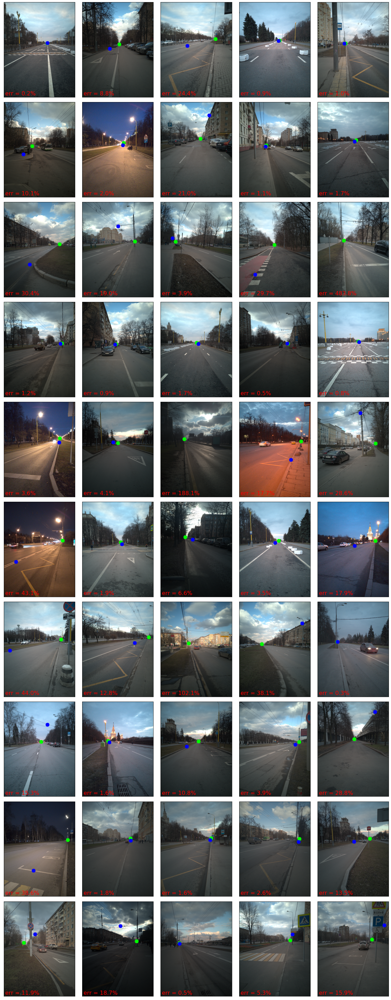

In [6]:
vanish_points_df['pred_x'] = [p[0] for p in pred_pts]
vanish_points_df['pred_y'] = [p[1] for p in pred_pts]
vanish_points_df['err'] = vanish_points_df.apply( lambda r:
    np.sqrt((r['x'] - r['pred_x'])**2 + (r['y'] - r['pred_y'])**2), axis=1
)

errors = []
fig = plt.figure(figsize=(16,40))
for i, img_name in enumerate(img_names):
    # original img
    img = cv2.cvtColor(cv2.imread(f'{IMGS_PATH}/{img_name}'), cv2.COLOR_BGR2RGB)
    # add real point
    pt = (vanish_points_df.iloc[i].x, vanish_points_df.iloc[i].y)
    img = cv2.circle(img, pt, radius=10, color=(0, 255, 0), thickness=-1)
    # add predicted point
    pred_pt = (vanish_points_df.iloc[i].pred_x, vanish_points_df.iloc[i].pred_y)
    img = cv2.circle(img, pred_pt, radius=10, color=(0, 0, 255), thickness=-1)
    
    # calculate error
    h, w, _ = img.shape
    norm_err = vanish_points_df.iloc[i].err / np.sqrt(h**2 + w**2)
    errors.append(norm_err)
    
    # plot
    ax = fig.add_subplot(10, 5, i+1)
    plt.imshow(img)
    plt.text(0.02, 0.02, f"err = {norm_err:.1%}", fontsize = 16, transform=ax.transAxes, color='red')
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout()

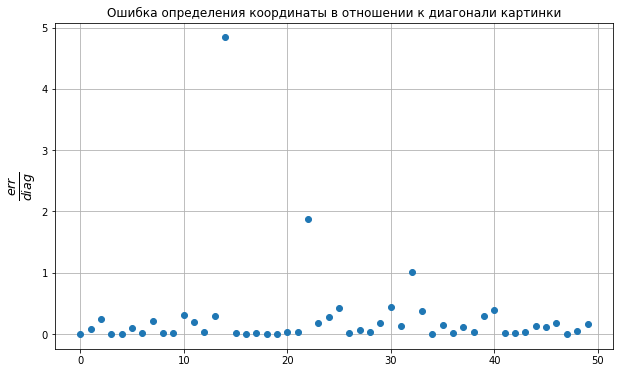

In [18]:
plt.figure(figsize=(10,6))
plt.plot(errors, 'o')
plt.grid()
plt.ylabel("$\\frac{err}{diag}$", fontsize=18)
plt.title('Ошибка определения координаты в отношении к диагонали картинки');

Точность не достаточно хорошая. Ошибка может достигать половины диагонали, в единичных случаях мы вообще не нашли точку в пределах картинки  

#### **Нейросетевой способ решения задачи:**
Вы можете подойти к решению задачи поиска точки схода прямых с точки зрения глубокого обучения. Обучите на представленном ниже наборе данных свёрточную нейронную сеть ResNet-50 для предсказания точки пересечения напрямую. На вход нейросети подаётся изображение, на котором нужно найти точку схода. Нейросеть предсказывает 2 числа: $(x_{pred}, y_{pred})$ - коодинаты точки схода. Между предсказанными координатами и истинными координатами из разметки, $(x_{true}, y_{true})$, в процессе обучения минимизируется евклидово расстояние:
$$
L = \frac{1}{N}\sum_{i=1}^N\left[(x^i_{pred} - x^i_{true})^2 + (y^i_{pred} - y^i_{true})^2\right]
$$
где N - размер батча.

Схематично процесс предсказания представлен на рисунке. Красная точка указывает истинные координаты точки схода прямых:

<img src="https://dl.dropboxusercontent.com/s/adu1baosbrrj5ui/resnet.png?dl=0" alt="drawing" width="800">

Для обучения нейросети выполните следующие шаги:
1. Загрузите набор данных для обучения по ссылке: https://disk.yandex.ru/d/ebRGghDv-aRKMg/dataset
2. Используйте изображения в папке *semenkov* для теста, отстальные для обучения (загрузчик данных будет дан ниже)
3. Возмите нейросеть ResNet-50 и поменяйте предсказывающую голову, подобно тому, как это было сделано в Задаче 2, где была отброшена ImageNet голова (матрица размера $2028\times1000$) на CIFAR-10 голову (матрица размера $2028\times10$). Вам нужно, чтобы предсказывались 2 числа. Можете выбрать в качестве головы матрицу размера $2028\times2$
4. Используйте $L_2$ фукцию потерь для обучения модели

In [4]:
from torch.utils.data import DataLoader, Dataset
from glob import glob
import pandas as pd
from skimage import io, transform
from pathlib import Path
import matplotlib.pyplot as plt

class VanishingPoints(Dataset):
    def __init__(self, data_dir: str, subset: str, transforms) -> None:
        super().__init__()
        self.transforms = transforms
        test_dir = 'semenkov'
        if subset == 'test':
            vanish_points = pd.read_csv(str(Path(data_dir) / test_dir / 'vanish_points.csv'), sep=';')
            vanish_points = vanish_points[vanish_points.comment!='there is no VP']
            self.image_paths = []
            self.vp_targets = []
            for row in vanish_points.values:
                self.image_paths.append(str(Path(data_dir) / test_dir/row[0]))
                self.vp_targets.append(np.array([row[1], row[2]]))
        elif subset == 'train':
            dataset_dirs = list(glob(str(Path(data_dir) / '*')))
            self.image_paths = []
            self.vp_targets = []
            for dir_path in dataset_dirs:
                if test_dir in dir_path:
                    continue
                #print(dir_path)
                csv_path = list(glob(str(Path(dir_path) / '*.csv')))[0]
                if 'sokol' not in dir_path:
                    
                    vanish_points = pd.read_csv(csv_path, sep=';')
                    if len(vanish_points.columns) < 3:
                        vanish_points = pd.read_csv(csv_path, sep=',')
                    vanish_points.columns = map(str.lower, vanish_points.columns)
                    vanish_points = vanish_points[vanish_points.x.isnull() == 0]
                else:
                    vanish_points = pd.read_csv(csv_path, names=['file', 'x', 'y', 'foo'], sep=';')
                if 'rychko' not in dir_path and 'Alkzir' not in dir_path:                    
                    for row in vanish_points.values:
                        name = row[0]
                        if '.png' not in name:
                            name += '.png'
                        vp_target=np.array([row[1], row[2]]).astype('float') 
                        if not np.isnan(vp_target).any() and (vp_target>=0).all():    
                            self.image_paths.append(str(Path(dir_path) / name))
                            self.vp_targets.append(np.array(vp_target))
                else:
                    for row in vanish_points.values:
                        vp_target=np.array([row[2], row[3]]).astype('float')
                        if not np.isnan(vp_target).any() and (vp_target>=0).all():
                            self.image_paths.append(str(Path(dir_path) / row[1]))
                            self.vp_targets.append(vp_target)
        else:
            raise ValueError


    def __getitem__(self, index):
        image = io.imread(self.image_paths[index])
        
        if(image.shape[2] == 4):#remove alpha
            image = image[:,:,0:3]
            
        vanish_point = self.vp_targets[index]
        image, vanish_point = self.transforms((image, vanish_point))
        return image, vanish_point

    def __len__(self):
        return len(self.image_paths)

C:\Users\Admin\anaconda3\envs\yolo5-env\lib\site-packages\skimage\io\manage_plugins.py:23: UserWarning: Your installed pillow version is < 8.1.2. Several security issues (CVE-2021-27921, CVE-2021-25290, CVE-2021-25291, CVE-2021-25293, and more) have been fixed in pillow 8.1.2 or higher. We recommend to upgrade this library.
  from .collection import imread_collection_wrapper


In [94]:
data_dir='Vanishing_data'
test_dir = 'semenkov'
dataset_dirs = list(glob(str(Path(data_dir) / '*')))
image_paths = []
vp_targets = []
for dir_path in dataset_dirs:
    if test_dir in dir_path:
        continue
    n_start=len (image_paths)  
    #print(dir_path)
    csv_path = list(glob(str(Path(dir_path) / '*.csv')))[0]
    if 'sokol' not in dir_path:

        vanish_points = pd.read_csv(csv_path, sep=';')
        if len(vanish_points.columns) < 3:
            vanish_points = pd.read_csv(csv_path, sep=',')
      
        vanish_points.columns = map(str.lower, vanish_points.columns)
        vanish_points = vanish_points[vanish_points.x.isnull() == 0]
    else:
        vanish_points = pd.read_csv(csv_path, names=['file', 'x', 'y', 'foo'], sep=';')
    if 'rychko' not in dir_path and 'Alkzir' not in dir_path:
        for row in vanish_points.values:
            name = row[0]
            if '.png' not in name:
                name += '.png'
            vp_target=np.array([row[1], row[2]]).astype('float') 
            if not np.isnan(vp_target).any() and (vp_target>=0).all():    
                image_paths.append(str(Path(dir_path) / name))
                vp_targets.append(vp_target)
    else:
        for row in vanish_points.values:            
            vp_target=np.array([row[2], row[3]]).astype('float')
            if not np.isnan(vp_target).any() and (vp_target>=0).all():
                image_paths.append(str(Path(dir_path) / row[1]))
                vp_targets.append(vp_target)                
    n_end=len (image_paths) 
    print(dir_path,n_end-n_start)
#print(vp_targets)
for i in image_paths:
    print(i)
    image = io.imread(i)

Vanishing_data\alchernyavskiy 32
Vanishing_data\Alkzir 94
Vanishing_data\anchernyavskiy 27
Vanishing_data\elokhin 49
Vanishing_data\florinsky 29
Vanishing_data\kaymakov 33
Vanishing_data\madina 50
Vanishing_data\petrov 42
Vanishing_data\rog 15
Vanishing_data\rychko 46
Vanishing_data\shutov 45
Vanishing_data\sokol 45
Vanishing_data\veld 31
Vanishing_data\alchernyavskiy\alc_2.png
Vanishing_data\alchernyavskiy\alc_3.png
Vanishing_data\alchernyavskiy\alc_4.png
Vanishing_data\alchernyavskiy\alc_5.png
Vanishing_data\alchernyavskiy\alc_8.png
Vanishing_data\alchernyavskiy\alc_9.png
Vanishing_data\alchernyavskiy\alc_10.png
Vanishing_data\alchernyavskiy\alc_11.png
Vanishing_data\alchernyavskiy\alc_12.png
Vanishing_data\alchernyavskiy\alc_13.png
Vanishing_data\alchernyavskiy\alc_14.png
Vanishing_data\alchernyavskiy\alc_15.png
Vanishing_data\alchernyavskiy\alc_16.png
Vanishing_data\alchernyavskiy\alc_18.png
Vanishing_data\alchernyavskiy\alc_19.png
Vanishing_data\alchernyavskiy\alc_20.png
Vanishing

Vanishing_data\florinsky\42mf.png
Vanishing_data\florinsky\45mf.png
Vanishing_data\florinsky\48mf.png
Vanishing_data\florinsky\49mf.png
Vanishing_data\kaymakov\Kir0.png
Vanishing_data\kaymakov\Kir1.png
Vanishing_data\kaymakov\Kir2.png
Vanishing_data\kaymakov\Kir3.png
Vanishing_data\kaymakov\Kir4.png
Vanishing_data\kaymakov\Kir6.png
Vanishing_data\kaymakov\Kir8.png
Vanishing_data\kaymakov\Kir9.png
Vanishing_data\kaymakov\Kir10.png
Vanishing_data\kaymakov\Kir13.png
Vanishing_data\kaymakov\Kir14.png
Vanishing_data\kaymakov\Kir16.png
Vanishing_data\kaymakov\Kir18.png
Vanishing_data\kaymakov\Kir20.png
Vanishing_data\kaymakov\Kir21.png
Vanishing_data\kaymakov\Kir23.png
Vanishing_data\kaymakov\Kir27.png
Vanishing_data\kaymakov\Kir28.png
Vanishing_data\kaymakov\Kir31.png
Vanishing_data\kaymakov\Kir32.png
Vanishing_data\kaymakov\Kir33.png
Vanishing_data\kaymakov\Kir35.png
Vanishing_data\kaymakov\Kir37.png
Vanishing_data\kaymakov\Kir38.png
Vanishing_data\kaymakov\Kir39.png
Vanishing_data\kaymako

Vanishing_data\sokol\sokol06.png
Vanishing_data\sokol\sokol07.png
Vanishing_data\sokol\sokol08.png
Vanishing_data\sokol\sokol10.png
Vanishing_data\sokol\sokol11.png
Vanishing_data\sokol\sokol12.png
Vanishing_data\sokol\sokol13.png
Vanishing_data\sokol\sokol14.png
Vanishing_data\sokol\sokol15.png
Vanishing_data\sokol\sokol16.png
Vanishing_data\sokol\sokol17.png
Vanishing_data\sokol\sokol18.png
Vanishing_data\sokol\sokol19.png
Vanishing_data\sokol\sokol20.png
Vanishing_data\sokol\sokol21.png
Vanishing_data\sokol\sokol22.png
Vanishing_data\sokol\sokol23.png
Vanishing_data\sokol\sokol24.png
Vanishing_data\sokol\sokol25.png
Vanishing_data\sokol\sokol26.png
Vanishing_data\sokol\sokol28.png
Vanishing_data\sokol\sokol29.png
Vanishing_data\sokol\sokol30.png
Vanishing_data\sokol\sokol31.png
Vanishing_data\sokol\sokol32.png
Vanishing_data\sokol\sokol33.png
Vanishing_data\sokol\sokol34.png
Vanishing_data\sokol\sokol35.png
Vanishing_data\sokol\sokol36.png
Vanishing_data\sokol\sokol37.png
Vanishing_

#### Базовые преобразования

In [5]:
#В связи с тем, что датасет ограничен добавим функций для аугментаций данных
import cv2
import math

class RandomRotation(object):
    def __init__(self, degrees, center=None):
        if type(degrees) == int:
            if degrees < 0:
                raise ValueError("If degrees is a single number, it must be positive.")
            self.degrees = (-degrees, degrees)
        else:
            if len(degrees) != 2:
                raise ValueError("If degrees is a sequence, it must be of len 2.")
            self.degrees = degrees

    def __call__(self, sample):
        angle = np.random.uniform(self.degrees[0], self.degrees[1])       
        image, point = sample
        h, w = image.shape[:2]
        center = [w/2, h/2]
        M = cv2.getRotationMatrix2D((w / 2, h / 2), angle, 1.0)
        image_rotate = cv2.warpAffine(image, M, (w, h))
               
        diff = point - center
        diff[1] = -diff[1]
        distance = np.sqrt(diff[0]**2 + diff[1]**2)
        if diff[0] == 0:
            if diff[1] >= 0:
                old_degree = 90
            if diff[1] < 0:
                old_degree = 270
        else:
            old_degree = np.arctan(diff[1]/diff[0])
            if diff[0] < 0:
                old_degree = old_degree + math.pi
        new_degree = old_degree + angle/57.3
        
        new_point = np.array([distance * np.cos(new_degree) + center[0], center[1] - distance * np.sin(new_degree) ])
 
        return image_rotate, new_point
    
class Rescale(object):
    """Rescale the image in a sample to a given size.

    Args:
        output_size (tuple or int): Desired output size. If tuple, output is
            matched to output_size. If int, smaller of image edges is matched
            to output_size keeping aspect ratio the same.
    """

    def __init__(self, output_size):
        assert isinstance(output_size, (int, tuple))
        self.output_size = output_size

    def __call__(self, sample):
        image, vanish_point = sample

        h, w = image.shape[:2]
        if isinstance(self.output_size, int):
            if h > w:
                new_h, new_w = self.output_size * h / w, self.output_size
            else:
                new_h, new_w = self.output_size, self.output_size * w / h
        else:
            new_h, new_w = self.output_size

        new_h, new_w = int(new_h), int(new_w)

        img = transform.resize(image, (new_h, new_w))

        # h and w are swapped for vanish_point because for images,
        # x and y axes are axis 1 and 0 respectively
        vanish_point = vanish_point * [new_w / w, new_h / h]

        return img, vanish_point
    
class RandomFlip(object):
    def __init__(self, rotation=True):
        self.rotation=rotation
        
    def __call__(self, sample):
        image, vanish_point = sample
        h, w = image.shape[:2]
        
        if np.random.random() < 0.5:
            image = np.fliplr(image)#по горизонтали
            vanish_point[0]=w-vanish_point[0]

        if self.rotation: 
            if np.random.random() < 0.5:
                image = np.rot90(image)#image.transpose(1,0,2) #поворот на 90 np.rot90(m)
                x=vanish_point[0]
                vanish_point[0]=vanish_point[1]
                vanish_point[1]=h-x
                
                if np.random.random() < 0.5:
                    image = np.fliplr(image)#по горизонтали
                    vanish_point[0]=w-vanish_point[0]

        return image, vanish_point
    
class RandomRescale(object):
    def __init__(self, k_low=0.8,k_high=1):
        self.k_low = k_low
        self.k_high = k_high

    def __call__(self, sample):
        image, vanish_point = sample
        
        r=np.random.uniform(low=self.k_low, high=self.k_high)

        h, w = image.shape[:2]
        new_h, new_w = int(h*r), int(w*r)
        
        if new_h<224:
            new_h,new_w =224,224
        
        
        img = transform.resize(image, (new_h, new_w))

        vanish_point = vanish_point * [new_w / w, new_h / h]

        return img, vanish_point
    
class RandomCrop(object):
    def __init__(self, output_size):
        assert isinstance(output_size, (int, tuple))
        if isinstance(output_size, int):
            self.output_size = (output_size, output_size)
        else:
            assert len(output_size) == 2
            self.output_size = output_size

    def __call__(self, sample):
        image, vanish_point = sample

        h, w = image.shape[:2]
        new_h, new_w = self.output_size
        
        if new_h<h:

            top = np.random.randint(0, h - new_h)
            left = np.random.randint(0, w - new_w)

            image = image[top: top + new_h,
                          left: left + new_w]

            vanish_point = vanish_point - [left, top]

        return image, vanish_point

class Brightness(object):

    def __init__(self, b_low=0.85,b_high=1.15,r_std=0.35):
        self.b_low = b_low
        self.b_high = b_high
        self.r_std = r_std


    def __call__(self, sample):
        image, vanish_point = sample
        if (image.any()>3):
            image=image/255
        
        random_b = np.random.uniform(low=self.b_low, high=self.b_high,size=1)   
        random_r = np.random.normal(0, self.r_std, 1)

        image = np.array(image, dtype = np.float64)
        image[:,:,0] = image[:,:,0]*(1+random_r)*random_b
        image[:,:,1] = image[:,:,1]*random_b
        image[:,:,2] = image[:,:,2]*(1-random_r*0.5)*random_b
        image[:,:,:][image[:,:,:]>1]  = 1
        #image[:,:,:][image[:,:,:]<0]  = 0
        #print(image1[0][0][2])

        #image = np.array(image, dtype = np.uint8)
        return image, vanish_point
    
class Crop(object):
    def __init__(self, output_size):
        assert isinstance(output_size, (int, tuple))
        if isinstance(output_size, int):
            self.output_size = (output_size, output_size)
        else:
            assert len(output_size) == 2
            self.output_size = output_size

    def __call__(self, sample):
        image, vanish_point = sample

        h, w = image.shape[:2]
        new_h, new_w = self.output_size
        top = int((h-new_h)/2.0)
        left = int((w-new_w)/2.0)

        image = image[top: top + new_h,
                      left: left + new_w]

        vanish_point = vanish_point - [left, top]

        return image, vanish_point
    
class ToTensor(object):
    """Convert ndarrays in sample to Tensors."""

    def __call__(self, sample):
        image, vanish_point = sample

        # swap color axis because
        # numpy image: H x W x C
        # torch image: C x H x W
        image = image.transpose((2, 0, 1))
        return torch.from_numpy(image).float(), torch.from_numpy(vanish_point).float()
    
class Normalize(object):
    """Normalize image."""
    def __init__(self, params):
        self.params = params
        self.norm = transforms.Normalize(
                    *self.params)
    def __call__(self, sample):
        image, vanish_point = sample
        return self.norm(image), vanish_point   


In [108]:
DATA_DIR_NEW = 'vdata/train'
vanish_points = pd.read_csv(str(Path(DATA_DIR_NEW) / 'vanish_points.csv'), sep=';')            
for row in vanish_points.values:
    pathimg=DATA_DIR_NEW + '/' + str(row[0])
    output=np.array([row[1], row[2]])
    f = open(pathimg.replace(os.path.splitext(pathimg)[-1], '_u.txt') , 'w')
    f.write('p ' + ' '.join(output.astype('str')) + '\n')
    f.close()

In [98]:
#Формируем сжатый датасет
DATA_DIR = 'Vanishing_data'
DATA_DIR_NEW = 'vdata/train'
recale_transforms = transforms.Compose([Rescale((280, 280)),])
test_set = VanishingPoints(DATA_DIR, 'train', recale_transforms)
files = []
vp_x = []
vp_y = []
for i in range(len(test_set)):
    image=test_set[i][0]
    io.imsave(DATA_DIR_NEW +"/"+str(i) +'.png' , image)
    files.append(str(i) +'.png')
    vp_x.append(test_set[i][1][0])
    vp_y.append(test_set[i][1][1])
df=pd.DataFrame({'file':files,'x':vp_x,'y':vp_y})
df.to_csv(DATA_DIR_NEW + '/vanish_points.csv', ';',index=False )

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

In [99]:
#Формируем сжатый тестовый датасет
DATA_DIR = 'Vanishing_data'
DATA_DIR_NEW = 'vdata/test'
recale_transforms = transforms.Compose([Rescale((224, 224)),])
test_set = VanishingPoints(DATA_DIR, 'test', recale_transforms)
files = []
vp_x = []
vp_y = []
for i in range(len(test_set)):
    image=test_set[i][0]
    io.imsave(DATA_DIR_NEW +"/"+str(i) +'.png' , image)
    files.append(str(i) +'.png')
    vp_x.append(test_set[i][1][0])
    vp_y.append(test_set[i][1][1])
df=pd.DataFrame({'file':files,'x':vp_x,'y':vp_y})
df.to_csv(DATA_DIR_NEW + '/vanish_points.csv', ';',index=False)

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

In [6]:
#Создадим класс для сжатого датасета
class VPoints(Dataset):
    def __init__(self, data_dir: str, subset: str, transforms) -> None:
        super().__init__()
        self.transforms = transforms
        if subset == 'test':            
            vanish_points = pd.read_csv(str(Path(data_dir) / subset / 'vanish_points.csv'), sep=';')            
            self.image_paths = []
            self.vp_targets = []
            for row in vanish_points.values:
                self.image_paths.append(str(Path(data_dir) / subset/row[0]))
                self.vp_targets.append(np.array([row[1], row[2]]))
        elif subset == 'train':
            vanish_points = pd.read_csv(str(Path(data_dir) / subset / 'vanish_points.csv'), sep=';')            
            self.image_paths = []
            self.vp_targets = []
            for row in vanish_points.values:
                self.image_paths.append(str(Path(data_dir) / subset/row[0]))
                self.vp_targets.append(np.array([row[1], row[2]]))
        else:
            raise ValueError


    def __getitem__(self, index):
        image = io.imread(self.image_paths[index])
        
        if(image.shape[2] == 4):#remove alpha
            image = image[:,:,0:3]
            
        vanish_point = self.vp_targets[index]
        image, vanish_point = self.transforms((image, vanish_point))
        return image, vanish_point

    def __len__(self):
        return len(self.image_paths)

In [21]:
DATA_DIR='vdata'

# используем GPU при наличии
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

mean = torch.tensor([0.4914, 0.4822, 0.4465], dtype=torch.float32)
std = torch.tensor([0.2023, 0.1994, 0.2010], dtype=torch.float32)

test_transforms = transforms.Compose([Rescale((224, 224)),
                              ToTensor(),
                               Normalize((mean.tolist(), std.tolist()))])

train_transforms = transforms.Compose([RandomRotation((-15,15)),
                                       Crop(260),
                                       RandomRescale(0.90,1.1),#1.1
                                       RandomFlip(rotation=False),
                                       RandomCrop(224),
                                       Rescale((224, 224)),
                                       Brightness (0.60,1.25,r_std=0.22),
                                       ToTensor(),
                               Normalize((mean.tolist(), std.tolist()))])
test_set = VPoints(DATA_DIR, 'test', test_transforms)
train_set = VPoints(DATA_DIR, 'train', train_transforms)
#download=True,

norm = transforms.Normalize(mean.tolist(), std.tolist())
unnorm = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

n_train, n_test = len(train_set), len(test_set)
print(n_train,n_test)

BATCH_SIZE = 50

train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=BATCH_SIZE,
    num_workers=0,
    shuffle=True
)

test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=BATCH_SIZE,
    num_workers=0
)

491 50


In [8]:
def show_data(images, vps=None,predict_vps=None, batch_size=4):
    if vps is not None:
        vps=vps.numpy()
        
    if predict_vps is not None:
        predict_vps=predict_vps.numpy()  
        
    n=min(len(images), batch_size)
    rows=int(n/4+1)
    plt.figure(figsize=(15,rows*4))
    images=unnorm(images)
    
    for i in range(n): 
        ax = plt.subplot(rows, 4, i+1)
        
        image = images[i].data       
        image = np.transpose(image, (1, 2, 0))   # transpose to go from torch to numpy image
        image = image.cpu().numpy()
        image = (image*255).astype('uint8')
       
        ax.imshow(np.squeeze(image), cmap='gray')
        if vps is not None:
            ax.scatter(vps[i, 0], vps[i, 1], s=50, marker='.', c='g')
            
        if predict_vps is not None:
            ax.scatter(predict_vps[i, 0], predict_vps[i, 1], s=30, marker='.', c='r')
        ax.axis('off')        

    plt.show()

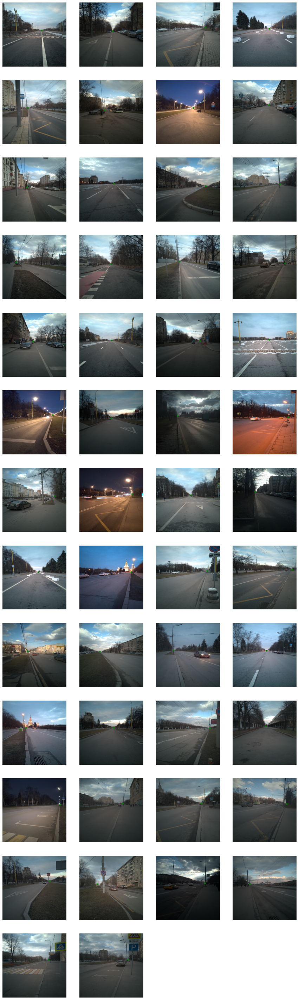

In [64]:
for i, sample in enumerate(test_loader):
        show_data(sample[0], sample[1], batch_size=BATCH_SIZE) 
        break

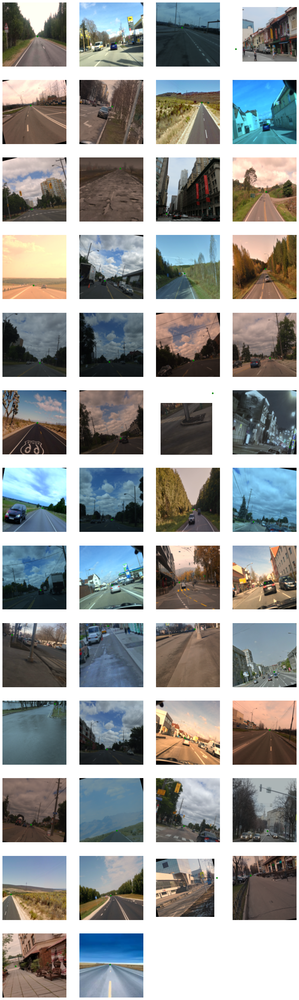

In [9]:
for i, sample in enumerate(train_loader):
        show_data(sample[0], sample[1], batch_size=BATCH_SIZE) 
        break

## Вариант №1 Модель с 1 головой

In [13]:
#init model
resnet50 = torchvision.models.resnet50(pretrained=True).to(device)    

new_modules = list(resnet50.children())[:-1] + [Flatten(), nn.Sequential(nn.Linear(2048, 2))]
resnet50_cifar = torch.nn.Sequential(*new_modules).to(device)

In [11]:
#Оптимайзер
#learning_rate=3e-4
learning_rate=5e-6
opt = torch.optim.Adam(resnet50_cifar.parameters(), lr=learning_rate)

#Функция потерь (Лосс функция)
loss_fn = nn.MSELoss()

#Число эпох
n_epochs =  40

In [12]:
def train_model(model, train_loader, val_loader, loss_fn, opt, n_epochs):
    '''
    model: нейросеть для обучения,
    train_loader, val_loader: загрузчики данных
    loss_fn: целевая метрика (которую будем оптимизировать)
    opt: оптимизатор (обновляет веса нейросети)
    n_epochs: кол-во эпох, полных проходов датасета
    '''
    train_loss = []
    test_loss = []
    
    for epoch in range(n_epochs):
        start_time = time.time()

        model.train(True) # enable dropout / batch_norm training behavior
        for X_batch, y_batch in train_loader:
            # move data to target device
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            # train on batch: compute loss, calc grads, perform optimizer step and zero the grads
            opt.zero_grad()
            predictions = model(X_batch)
            loss = loss_fn(predictions, y_batch)
            loss.backward()
#             torch.nn.utils.clip_grad_norm_(model.parameters(), 5)
            opt.step()
            train_loss.append(loss.item())

        model.train(False) # disable dropout / use averages for batch_norm
        for X_batch, y_batch in val_loader:
            # move data to target device
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            # compute logits
            predictions = model(X_batch)
            loss = loss_fn(predictions, y_batch)
            test_loss.append(loss.item())


        # print the results for this epoch:
        print(f'Epoch {epoch + 1} of {n_epochs} took {time.time() - start_time:.3f}s')

        train_loss_value = np.mean(train_loss[-n_train // BATCH_SIZE :])
        test_loss_value = np.mean(test_loss[-n_test // BATCH_SIZE :]) 
        
        print(f"  train loss: \t{train_loss_value:.4f} test loss \t {test_loss_value:.4f}")

    return train_loss, test_loss_value

In [15]:
#Последние 80 эпох обучения
learning_rate=2e-5
opt = torch.optim.Adam(resnet50_cifar.parameters(), lr=learning_rate)
n_epochs =  80
train_loss, test_loss = train_model(resnet50_cifar,
                                         train_loader,
                                         test_loader,
                                         loss_fn,
                                         opt,
                                         n_epochs)

Epoch 1 of 80 took 19.738s
  train loss: 	85.8138 test loss 	 17.5789
Epoch 2 of 80 took 19.558s
  train loss: 	79.2334 test loss 	 16.0485
Epoch 3 of 80 took 19.576s
  train loss: 	78.3866 test loss 	 15.8088
Epoch 4 of 80 took 19.586s
  train loss: 	69.7194 test loss 	 16.0300
Epoch 5 of 80 took 19.558s
  train loss: 	74.3149 test loss 	 15.8524
Epoch 6 of 80 took 19.577s
  train loss: 	93.3589 test loss 	 16.8755
Epoch 7 of 80 took 19.556s
  train loss: 	81.6082 test loss 	 16.3609
Epoch 8 of 80 took 19.541s
  train loss: 	91.5671 test loss 	 17.9046
Epoch 9 of 80 took 19.555s
  train loss: 	79.0321 test loss 	 17.4387
Epoch 10 of 80 took 19.611s
  train loss: 	93.5526 test loss 	 18.8906
Epoch 11 of 80 took 19.590s
  train loss: 	54.2146 test loss 	 16.4114
Epoch 12 of 80 took 19.553s
  train loss: 	66.2638 test loss 	 16.3691
Epoch 13 of 80 took 19.507s
  train loss: 	64.7122 test loss 	 16.7147
Epoch 14 of 80 took 19.546s
  train loss: 	69.1244 test loss 	 17.0952
Epoch 15 of 80 

Для оценки качества модели ввел 3 метрики: 
    среднее расстояние между предсказаннами точками схождения и тестовыми (distance_mean)
    доля точек с отклонением меньше 5 пикселей (distance accuracy (<5))
    доля точкет с отклонением меньше 10 пикселей (distance accuracy (<10))

distance accuracy (<5): 0.72
distance accuracy (<10): 0.96
distance mean: 4.102604911327362


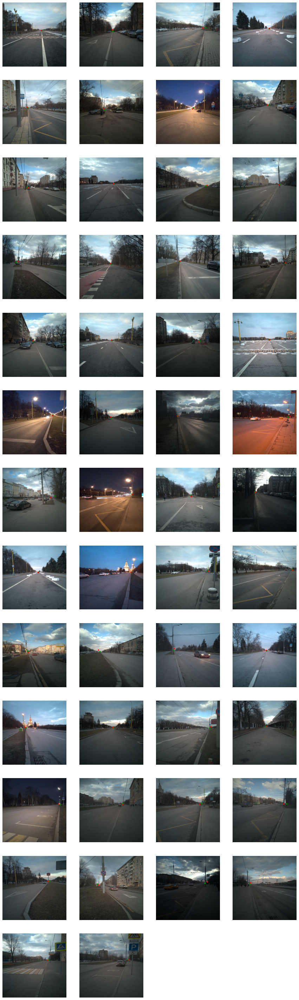

In [17]:
from scipy.spatial import distance

resnet50_cifar.train(False) # disable dropout / use averages for batch_norm
distance_array=[]  
for X_batch, y_batch in test_loader:
    predictions = resnet50_cifar(X_batch.to(device))
    tp=y_batch.detach()
    pp=predictions.detach().cpu()
    distance_array=np.array([distance.euclidean(a, b) for a, b in zip(tp, pp)])    
    distance_mean = np.mean(distance_array)
    distance_accuracy=np.mean(distance_array<5)
    distance_accuracy10=np.mean(distance_array<10)
    print('distance accuracy (<5):',distance_accuracy)
    print('distance accuracy (<10):',distance_accuracy10)
    print('distance mean:',distance_mean)
    show_data(X_batch, y_batch,predictions.detach().cpu(), batch_size=BATCH_SIZE)
    break   

In [ ]:
distance accuracy (<5): 0.72
distance accuracy (<10): 0.96
distance mean: 4.102604911327362

### Выводы
Модель хорошо предсказывает точки, однако обучение не стабильно и в отдельных случаях не совсем точно предсказывает точку схождения. В результате среднее расстояние между предсказанием и тестом составило 4,1.  Возможно, если мы увеличим количество голов, каждая из которых будет предсказывать положение точки на ограниченном прямоугольнике, точноть модели повысится. Проверим данную гипотизу в варианте решения №2.

In [18]:
#Сохренение модели
model_dir = 'saved_models/'
model_name = 'wp_07.pt'
model_dir =model_dir+model_name
print(model_dir)

torch.save(resnet50_cifar, model_dir)

saved_models/wp_07.pt


In [20]:
#Загрузка модели
model_dir = 'saved_models/'
model_name = 'wp_07.pt'
model_dir =model_dir+model_name

resnet50_cifar = torch.load(model_dir)

## Вариант 2 Модель с 256 головами

In [12]:
# используем GPU при наличии
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

device(type='cuda')

In [17]:
#Добавим ряд функций для создания сетки и извления точек из сетки
img_size=224
stride = 28
subdivisions_img=img_size//stride #8
subdivisions_out_img = int(subdivisions_img*0.5)
subdivisions=subdivisions_img+subdivisions_out_img*2
center_cell = stride / 2
print ('subdivisions_img:',subdivisions_img,'subdivisions_out_img:',subdivisions_out_img)

def point_to_grid(point):
    x,y=point[0],point[1]
    grid=np.zeros((subdivisions,subdivisions,3))    
    x=x+subdivisions_out_img*stride
    y=y+subdivisions_out_img*stride
    row=int(x//stride)
    col=int(y//stride)
    #print(row,col)
    if (row>=0 and col>=0 and row <subdivisions and col <subdivisions):
        grid[row,col,0] = 1
        grid[row,col,1] = (x-row*stride-center_cell)/center_cell
        grid[row,col,2] = (y-col*stride-center_cell)/center_cell

    return grid

def get_best_points_from_grid (grid):
    grid=grid.reshape(-1,3)
    best_index=grid[:,0].argmax()
    row=best_index//(subdivisions*subdivisions)
    col=best_index-row*subdivisions
    x = grid[best_index][1]*center_cell+center_cell+row*stride-subdivisions_out_img*stride
    y = grid[best_index][2]*center_cell+center_cell+col*stride-subdivisions_out_img*stride
    return x,y

def get_best_points_from_tensor_grid (grid):
    grid=grid.view(-1,subdivisions*subdivisions,3)
    n=torch.arange(grid.shape[0])*(subdivisions*subdivisions)
    best_indexes=grid[:,:,0].max(1)[1]
    best_rows=best_indexes//(subdivisions)
    best_columns=best_indexes-best_rows*subdivisions
    points= grid.view(-1,3)[best_indexes+n,1:].view(-1,2)
    points[:,0]=points[:,0]*center_cell+center_cell+best_rows[:]*stride-subdivisions_out_img*stride
    points[:,1]=points[:,1]*center_cell+center_cell+best_columns[:]*stride-subdivisions_out_img*stride
    return points

class ToGrid(object):
    def __call__(self, sample):
        image, vanish_point = sample
        return image, point_to_grid(vanish_point) 

def get_best_indexes (grid):
    grid=grid.view(-1,subdivisions*subdivisions,3)
    n=torch.arange(grid.shape[0])*(subdivisions*subdivisions)
    best_indexes=grid[:,:,0].max(1)[1].data
    return best_indexes    

subdivisions_img: 8 subdivisions_out_img: 4


In [27]:
#init model 
#Инициализируем модель с 256 головами (64 головы на видимую часть картинки, остальные на невидимую) 
resnet50 = torchvision.models.resnet50(pretrained=True).to(device)    
head=subdivisions*subdivisions*3
new_modules = list(resnet50.children())[:-1] + [Flatten(), nn.Sequential(nn.Linear(2048, head))]
resnet50_cifar = torch.nn.Sequential(*new_modules).to(device)
print(2048,head)

2048 768


In [18]:
DATA_DIR='vdata'
mean = torch.tensor([0.4914, 0.4822, 0.4465], dtype=torch.float32)
std = torch.tensor([0.2023, 0.1994, 0.2010], dtype=torch.float32)

test_transforms = transforms.Compose([Rescale((224, 224)),
                              ToGrid(),
                              ToTensor(),
                               Normalize((mean.tolist(), std.tolist()))])

train_transforms = transforms.Compose([
                                       RandomRotation((-15,15)),
                                       Crop(260),
                                       RandomRescale(0.90,1.1),#1.1
                                       RandomFlip(rotation=False),
                                       RandomCrop(224),
                                       Rescale((224, 224)),
                                       Brightness (0.60,1.25,r_std=0.22),
                                       ToGrid(),
                                       ToTensor(),
                                       Normalize((mean.tolist(), std.tolist()))
                                        ])
test_set = VPoints(DATA_DIR, 'test', test_transforms)
train_set = VPoints(DATA_DIR, 'train', train_transforms)
#download=True,

norm = transforms.Normalize(mean.tolist(), std.tolist())
unnorm = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

n_train, n_test = len(train_set), len(test_set)
print(n_train,n_test)

BATCH_SIZE = 50

train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=BATCH_SIZE,
    num_workers=0,
    shuffle=True
)

test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=BATCH_SIZE,
    num_workers=0
)

491 50


In [11]:
#Оптимайзер
learning_rate=3e-4
#learning_rate=5e-6
opt = torch.optim.Adam(resnet50_cifar.parameters(), lr=learning_rate)

#Функция потерь (Лосс функция)
loss_fn_bse = nn.BCEWithLogitsLoss()
loss_fn_mse = nn.MSELoss()

#Число эпох
n_epochs =  50

In [10]:
def train_model(model, train_loader, val_loader,loss_fn_bse, loss_fn_mse, opt, n_epochs):
    '''
    model: нейросеть для обучения,
    train_loader, val_loader: загрузчики данных
    loss_fn: целевая метрика (которую будем оптимизировать)
    opt: оптимизатор (обновляет веса нейросети)
    n_epochs: кол-во эпох, полных проходов датасета
    '''
    train_loss_bce = []
    test_loss_bce = []
    train_loss_mse = []
    test_loss_mse = []
    train_loss = []
    test_loss = []
    val_accuracy=0
    
    for epoch in range(n_epochs):
        start_time = time.time()
        
        model.train(True) # enable dropout / batch_norm training behavior
        for X_batch, y_batch in train_loader:
            # move data to target device
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            # train on batch: compute loss, calc grads, perform optimizer step and zero the grads
            opt.zero_grad()
            predictions = model(X_batch)
            
            predictions=predictions.view(-1, 3) 
            y_batch=y_batch.view(-1, 3) 
            ind=y_batch[:,0]>0
            target = y_batch.clone().detach()
            loss_bce = loss_fn_bse(predictions[:,0], target[:,0])
            loss_mse = loss_fn_mse(predictions[ind,1:] , y_batch[ind,1:])                       

            loss=loss_bce+loss_mse

            loss.backward()
#             torch.nn.utils.clip_grad_norm_(model.parameters(), 5)
            opt.step()
            train_loss_bce.append(loss_bce.item())
            train_loss_mse.append(loss_mse.item())
            train_loss.append(loss.item())

        model.train(False) # disable dropout / use averages for batch_norm
        for X_batch, y_batch in val_loader:
            # move data to target device
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
   
            predictions = model(X_batch)
            
            predictions=predictions.view(-1, 3) 
            y_batch=y_batch.view(-1, 3) 
            ind=y_batch[:,0]>0
            target = y_batch.clone().detach()
            loss_bce = loss_fn_bse(predictions[:,0], target[:,0])
            loss_mse = loss_fn_mse(predictions[ind,1:] , y_batch[ind,1:]) 
            
            test_loss_bce.append(loss_bce.item())
            test_loss_mse.append(loss_mse.item())
            loss=loss_bce+loss_mse
            test_loss.append(loss.item())               
            val_accuracy = np.mean( get_best_indexes(predictions).cpu().numpy() == get_best_indexes(target).cpu().numpy() )

        # print the results for this epoch:
        print(f'Epoch {epoch + 1} of {n_epochs} took {time.time() - start_time:.3f}s')

        train_loss_bce_value = np.mean(train_loss_bce[-n_train // BATCH_SIZE :])
        test_loss_bce_value = np.mean(test_loss_bce[-n_test // BATCH_SIZE :]) 
        train_loss_mse_value = np.mean(train_loss_mse[-n_train // BATCH_SIZE :])
        test_loss_mse_value = np.mean(test_loss_mse[-n_test // BATCH_SIZE :]) 
        train_loss_value = np.mean(train_loss[-n_train // BATCH_SIZE :])
        test_loss_value = np.mean(test_loss[-n_test // BATCH_SIZE :]) 
        
        print(f"  train loss: \t{train_loss_value:.4f} bce: {train_loss_bce_value:.4f} mse: {train_loss_mse_value:.4f}" )
        print(f"  test loss: \t{test_loss_value:.4f} bce: {test_loss_bce_value:.4f} mse: {test_loss_mse_value:.4f} accuracy: {val_accuracy:.2f}" )

    return train_loss, test_loss_value

In [30]:
#Первые 50 эпох обучения
train_loss, test_loss = train_model(resnet50_cifar,
                                         train_loader,
                                         test_loader,
                                         loss_fn_bse,
                                         loss_fn_mse,
                                         opt,
                                         n_epochs)

Epoch 1 of 50 took 21.964s
  train loss: 	0.7967 bce 	 0.3367 mse 	 0.4601
  test loss: 	0.5575 bce 	 0.0693 mse 	 0.4882
Epoch 2 of 50 took 19.997s
  train loss: 	0.5729 bce 	 0.0773 mse 	 0.4956
  test loss: 	0.6722 bce 	 0.0275 mse 	 0.6447
Epoch 3 of 50 took 19.655s
  train loss: 	0.4823 bce 	 0.0613 mse 	 0.4210
  test loss: 	0.7564 bce 	 0.0278 mse 	 0.7286
Epoch 4 of 50 took 19.655s
  train loss: 	0.4485 bce 	 0.0457 mse 	 0.4028
  test loss: 	0.5196 bce 	 0.0281 mse 	 0.4915
Epoch 5 of 50 took 19.741s
  train loss: 	0.3973 bce 	 0.0351 mse 	 0.3621
  test loss: 	0.4128 bce 	 0.0284 mse 	 0.3843
Epoch 6 of 50 took 19.721s
  train loss: 	0.3628 bce 	 0.0391 mse 	 0.3236
  test loss: 	0.4073 bce 	 0.0296 mse 	 0.3776
Epoch 7 of 50 took 19.654s
  train loss: 	0.3908 bce 	 0.0347 mse 	 0.3561
  test loss: 	0.3745 bce 	 0.0288 mse 	 0.3457
Epoch 8 of 50 took 19.712s
  train loss: 	0.3683 bce 	 0.0356 mse 	 0.3327
  test loss: 	0.3377 bce 	 0.0347 mse 	 0.3030
Epoch 9 of 50 took 19.68

In [17]:
#Посление 50 эпох обучения
learning_rate=5e-5
opt = torch.optim.Adam(resnet50_cifar.parameters(), lr=learning_rate)

train_loss, test_loss = train_model(resnet50_cifar,
                                         train_loader,
                                         test_loader,
                                         loss_fn_bse,
                                         loss_fn_mse,
                                         opt,
                                         n_epochs)

Epoch 1 of 50 took 19.725s
  train loss: 	0.0160 bce: 0.0051 mse: 0.0109
  test loss: 	0.0265 bce: 0.0030 mse: 0.0235 accuracy: 0.96
Epoch 2 of 50 took 19.664s
  train loss: 	0.0204 bce: 0.0053 mse: 0.0151
  test loss: 	0.0339 bce: 0.0030 mse: 0.0308 accuracy: 0.96
Epoch 3 of 50 took 19.681s
  train loss: 	0.0164 bce: 0.0052 mse: 0.0112
  test loss: 	0.0328 bce: 0.0031 mse: 0.0297 accuracy: 0.94
Epoch 4 of 50 took 19.691s
  train loss: 	0.0199 bce: 0.0051 mse: 0.0148
  test loss: 	0.0285 bce: 0.0031 mse: 0.0254 accuracy: 0.96
Epoch 5 of 50 took 19.663s
  train loss: 	0.0162 bce: 0.0051 mse: 0.0111
  test loss: 	0.0294 bce: 0.0032 mse: 0.0262 accuracy: 0.96
Epoch 6 of 50 took 19.642s
  train loss: 	0.0157 bce: 0.0049 mse: 0.0108
  test loss: 	0.0313 bce: 0.0031 mse: 0.0282 accuracy: 0.96
Epoch 7 of 50 took 19.691s
  train loss: 	0.0177 bce: 0.0051 mse: 0.0126
  test loss: 	0.0288 bce: 0.0031 mse: 0.0256 accuracy: 0.94
Epoch 8 of 50 took 19.634s
  train loss: 	0.0163 bce: 0.0050 mse: 0.0

In [18]:
#Сохренение модели
model_dir = 'saved_models/'
model_name = 'gridwp_010.pt'
model_dir =model_dir+model_name
print(model_dir)

torch.save(resnet50_cifar, model_dir)

saved_models/gridwp_010.pt


### Оценка результатов модели с 256 головами

cell accuracy: 0.96
distance accuracy (<5): 0.94
distance accuracy (<10): 0.96
distance mean: 2.8287647676467897


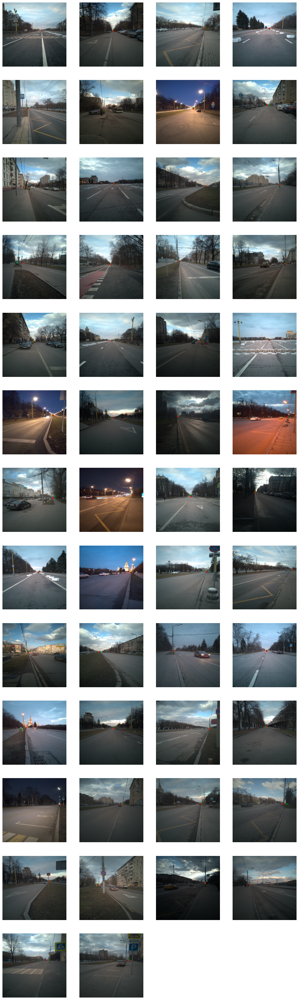

In [19]:
from scipy.spatial import distance

resnet50_cifar.train(False) # disable dropout / use averages for batch_norm
distance_array=[]  
for X_batch, y_batch in test_loader:
    predictions = resnet50_cifar(X_batch.to(device))
    target = y_batch.clone().detach()
    cell_accuracy = np.mean( get_best_indexes(predictions).cpu().numpy() == get_best_indexes(target).cpu().numpy() )
    print('cell accuracy:',cell_accuracy)    
    tp=get_best_points_from_tensor_grid(y_batch)
    pp=get_best_points_from_tensor_grid(predictions.detach().cpu())
    distance_array=np.array([distance.euclidean(a, b) for a, b in zip(tp, pp)])    
    distance_mean = np.mean(distance_array)
    distance_accuracy=np.mean(distance_array<5)
    distance_accuracy10=np.mean(distance_array<10)
    print('distance accuracy (<5):',distance_accuracy)
    print('distance accuracy (<10):',distance_accuracy10)
    print('distance mean:',distance_mean)
    show_data(X_batch, get_best_points_from_tensor_grid(y_batch),get_best_points_from_tensor_grid(predictions.detach().cpu()), batch_size=BATCH_SIZE) 
    
    
    break

In [ ]:
#Результаты с 1 головой:
distance accuracy (<5): 0.72
distance accuracy (<10): 0.96
distance mean: 4.102604911327362

#Результаты с 256 головами:
cell accuracy: 0.96
distance accuracy (<5): 0.94
distance accuracy (<10): 0.96
distance mean: 2.8287647676467897

### Вывод
Гипотиза подтвердилась модель с 256 головами более точно предсказвает точку скхождения. Среднее расстояние уменьшилось на 30%. Также уменьшилось количество точек с отклонением 5 пиксилей на 22 пп. Однако мы видем, что с таким количество голов в 6% случаях головы ошибаются с определение квадрата, в котором находится точка схождения. Возможно, что если уменьшить количество голов, то точность определения кдвадратов увеличится и качество результатов уличшится. Проверим эту гипотизу. Уменьшим количество голов до 64.

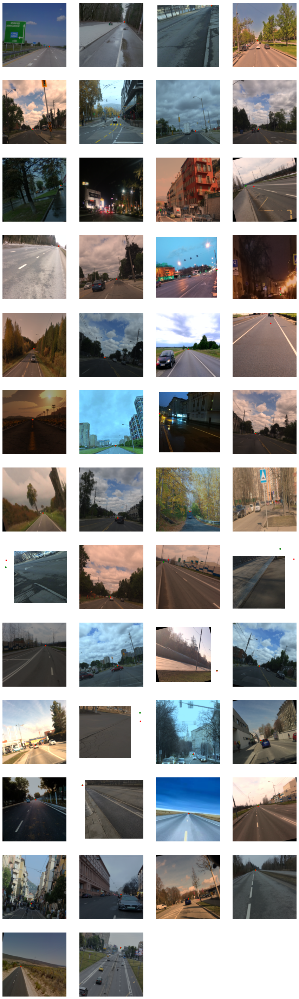

In [32]:
#Примеры работы модели на тренировочном датасете
resnet50_cifar.train(False) # disable dropout / use averages for batch_norm
  
for X_batch, y_batch in train_loader:
    predictions = resnet50_cifar(X_batch.to(device))
    show_data(X_batch, get_best_points_from_tensor_grid(y_batch),get_best_points_from_tensor_grid(predictions.detach().cpu()), batch_size=BATCH_SIZE) 
    break

In [14]:
#Загрузка модели
model_dir = 'saved_models/'
model_name = 'gridwp_009.pt'
model_dir =model_dir+model_name

resnet50_cifar = torch.load(model_dir)

## Вариант 3 Модель с 64 головами

In [11]:
img_size=224
stride = 56
subdivisions_img=img_size//stride #8
subdivisions_out_img = int(subdivisions_img*0.5)
subdivisions=subdivisions_img+subdivisions_out_img*2
center_cell = stride / 2
print ('subdivisions_img:',subdivisions_img,'subdivisions_out_img:',subdivisions_out_img)
 

def point_to_grid(point):
    x,y=point[0],point[1]
    grid=np.zeros((subdivisions,subdivisions,3))    
    x=x+subdivisions_out_img*stride
    y=y+subdivisions_out_img*stride
    row=int(x//stride)
    col=int(y//stride)
    #print(row,col)
    if (row>=0 and col>=0 and row <subdivisions and col <subdivisions):
        grid[row,col,0] = 1
        grid[row,col,1] = (x-row*stride-center_cell)/center_cell
        grid[row,col,2] = (y-col*stride-center_cell)/center_cell

    return grid

def get_best_points_from_grid (grid):
    grid=grid.reshape(-1,3)
    best_index=grid[:,0].argmax()
    row=best_index//(subdivisions*subdivisions)
    col=best_index-row*subdivisions
    x = grid[best_index][1]*center_cell+center_cell+row*stride-subdivisions_out_img*stride
    y = grid[best_index][2]*center_cell+center_cell+col*stride-subdivisions_out_img*stride
    return x,y

def get_best_points_from_tensor_grid (grid):
    grid=grid.view(-1,subdivisions*subdivisions,3)
    n=torch.arange(grid.shape[0])*(subdivisions*subdivisions)
    best_indexes=grid[:,:,0].max(1)[1]
    best_rows=best_indexes//(subdivisions)
    best_columns=best_indexes-best_rows*subdivisions
    points= grid.view(-1,3)[best_indexes+n,1:].view(-1,2)
    points[:,0]=points[:,0]*center_cell+center_cell+best_rows[:]*stride-subdivisions_out_img*stride
    points[:,1]=points[:,1]*center_cell+center_cell+best_columns[:]*stride-subdivisions_out_img*stride
    return points

class ToGrid(object):
    def __call__(self, sample):
        image, vanish_point = sample
        return image, point_to_grid(vanish_point) 

def get_best_indexes (grid):
    grid=grid.view(-1,subdivisions*subdivisions,3)
    n=torch.arange(grid.shape[0])*(subdivisions*subdivisions)
    best_indexes=grid[:,:,0].max(1)[1].data
    return best_indexes


subdivisions_img: 4 subdivisions_out_img: 2


In [10]:
#init model
#Инициализируем модель весами на основе предыдущей обученной модели 
model_dir = 'saved_models/'
model_name = 'gridwp_008.pt'
model_dir =model_dir+model_name
resnet50 = torch.load(model_dir)
  
head=subdivisions*subdivisions*3
new_modules = list(resnet50.children())[:-1] + [Flatten(), nn.Sequential(nn.Linear(2048, head))]
resnet50_cifar = torch.nn.Sequential(*new_modules).to(device)
print(2048,head)

2048 192


In [14]:
#Первые 50 эпох обучения
learning_rate=4e-4
opt = torch.optim.Adam(resnet50_cifar.parameters(), lr=learning_rate)

train_loss, test_loss = train_model(resnet50_cifar,
                                         train_loader,
                                         test_loader,
                                         loss_fn_bse,
                                         loss_fn_mse,
                                         opt,
                                         n_epochs)

Epoch 1 of 50 took 20.935s
  train loss: 	0.5657 bce: 0.3501 mse: 0.2156
  test loss: 	0.2401 bce: 0.1163 mse: 0.1238 accuracy: 0.00
Epoch 2 of 50 took 19.972s
  train loss: 	0.2371 bce: 0.0798 mse: 0.1573
  test loss: 	0.1810 bce: 0.0717 mse: 0.1092 accuracy: 0.00
Epoch 3 of 50 took 19.615s
  train loss: 	0.1811 bce: 0.0639 mse: 0.1172
  test loss: 	0.2211 bce: 0.0583 mse: 0.1627 accuracy: 0.06
Epoch 4 of 50 took 19.604s
  train loss: 	0.1598 bce: 0.0585 mse: 0.1013
  test loss: 	0.1656 bce: 0.0516 mse: 0.1140 accuracy: 0.10
Epoch 5 of 50 took 19.622s
  train loss: 	0.1504 bce: 0.0570 mse: 0.0934
  test loss: 	0.1513 bce: 0.0492 mse: 0.1021 accuracy: 0.08
Epoch 6 of 50 took 19.583s
  train loss: 	0.1264 bce: 0.0516 mse: 0.0748
  test loss: 	0.0970 bce: 0.0485 mse: 0.0485 accuracy: 0.08
Epoch 7 of 50 took 19.617s
  train loss: 	0.1218 bce: 0.0481 mse: 0.0737
  test loss: 	0.0756 bce: 0.0427 mse: 0.0330 accuracy: 0.62
Epoch 8 of 50 took 19.600s
  train loss: 	0.1171 bce: 0.0479 mse: 0.0

In [15]:
#Промежуточные 50 эпох обучения
learning_rate=5e-5
opt = torch.optim.Adam(resnet50_cifar.parameters(), lr=learning_rate)

train_loss, test_loss = train_model(resnet50_cifar,
                                         train_loader,
                                         test_loader,
                                         loss_fn_bse,
                                         loss_fn_mse,
                                         opt,
                                         n_epochs)

Epoch 1 of 50 took 19.682s
  train loss: 	0.0457 bce: 0.0178 mse: 0.0279
  test loss: 	0.0250 bce: 0.0107 mse: 0.0143 accuracy: 0.94
Epoch 2 of 50 took 19.691s
  train loss: 	0.0406 bce: 0.0172 mse: 0.0234
  test loss: 	0.0254 bce: 0.0097 mse: 0.0157 accuracy: 0.94
Epoch 3 of 50 took 19.660s
  train loss: 	0.0366 bce: 0.0170 mse: 0.0196
  test loss: 	0.0305 bce: 0.0090 mse: 0.0216 accuracy: 0.98
Epoch 4 of 50 took 19.664s
  train loss: 	0.0366 bce: 0.0167 mse: 0.0198
  test loss: 	0.0265 bce: 0.0086 mse: 0.0179 accuracy: 0.98
Epoch 5 of 50 took 19.675s
  train loss: 	0.0325 bce: 0.0164 mse: 0.0160
  test loss: 	0.0277 bce: 0.0086 mse: 0.0191 accuracy: 0.98
Epoch 6 of 50 took 19.667s
  train loss: 	0.0345 bce: 0.0161 mse: 0.0183
  test loss: 	0.0270 bce: 0.0082 mse: 0.0188 accuracy: 0.98
Epoch 7 of 50 took 19.726s
  train loss: 	0.0302 bce: 0.0162 mse: 0.0140
  test loss: 	0.0267 bce: 0.0083 mse: 0.0184 accuracy: 0.98
Epoch 8 of 50 took 19.664s
  train loss: 	0.0285 bce: 0.0153 mse: 0.0

In [14]:
#Последние 50 эпох обучения
learning_rate=2e-5
n_epochs=50
opt = torch.optim.Adam(resnet50_cifar.parameters(), lr=learning_rate)

train_loss, test_loss = train_model(resnet50_cifar,
                                         train_loader,
                                         test_loader,
                                         loss_fn_bse,
                                         loss_fn_mse,
                                         opt,
                                         n_epochs)

Epoch 1 of 50 took 20.774s
  train loss: 	0.0200 bce: 0.0113 mse: 0.0086
  test loss: 	0.0165 bce: 0.0038 mse: 0.0127 accuracy: 1.00
Epoch 2 of 50 took 19.627s
  train loss: 	0.0194 bce: 0.0112 mse: 0.0082
  test loss: 	0.0158 bce: 0.0040 mse: 0.0118 accuracy: 0.98
Epoch 3 of 50 took 19.603s
  train loss: 	0.0193 bce: 0.0103 mse: 0.0090
  test loss: 	0.0155 bce: 0.0041 mse: 0.0115 accuracy: 0.98
Epoch 4 of 50 took 19.570s
  train loss: 	0.0194 bce: 0.0103 mse: 0.0091
  test loss: 	0.0154 bce: 0.0039 mse: 0.0115 accuracy: 0.98
Epoch 5 of 50 took 19.604s
  train loss: 	0.0193 bce: 0.0103 mse: 0.0091
  test loss: 	0.0160 bce: 0.0039 mse: 0.0120 accuracy: 0.98
Epoch 6 of 50 took 19.600s
  train loss: 	0.0191 bce: 0.0108 mse: 0.0083
  test loss: 	0.0150 bce: 0.0037 mse: 0.0113 accuracy: 0.98
Epoch 7 of 50 took 19.554s
  train loss: 	0.0179 bce: 0.0107 mse: 0.0072
  test loss: 	0.0143 bce: 0.0035 mse: 0.0108 accuracy: 1.00
Epoch 8 of 50 took 19.657s
  train loss: 	0.0208 bce: 0.0120 mse: 0.0

In [15]:
#Сохренение модели
model_dir = 'saved_models/'
model_name = 'gridwp2_02.pt'
model_dir =model_dir+model_name
print(model_dir)

torch.save(resnet50_cifar, model_dir)

saved_models/gridwp2_02.pt


### Оценка модели с 64 головами

cell accuracy: 1.0
distance accuracy (<5): 0.94
distance accuracy (<10): 0.96
distance mean: 2.676976548433304


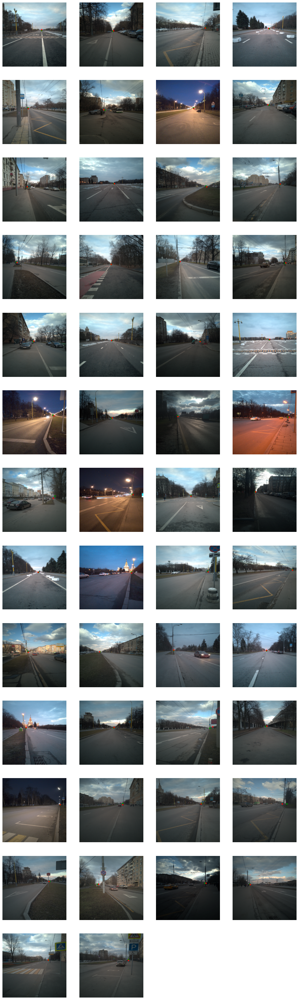

In [13]:
from scipy.spatial import distance

resnet50_cifar.train(False) # disable dropout / use averages for batch_norm
distance_array=[]  
for X_batch, y_batch in test_loader:
    predictions = resnet50_cifar(X_batch.to(device))
    target = y_batch.clone().detach()
    cell_accuracy = np.mean( get_best_indexes(predictions).cpu().numpy() == get_best_indexes(target).cpu().numpy() )
    print('cell accuracy:',cell_accuracy)    
    tp=get_best_points_from_tensor_grid(y_batch)
    pp=get_best_points_from_tensor_grid(predictions.detach().cpu())
    distance_array=np.array([distance.euclidean(a, b) for a, b in zip(tp, pp)])    
    distance_mean = np.mean(distance_array)
    distance_accuracy=np.mean(distance_array<5)
    distance_accuracy10=np.mean(distance_array<10)
    print('distance accuracy (<5):',distance_accuracy)
    print('distance accuracy (<10):',distance_accuracy10)
    print('distance mean:',distance_mean)
    show_data(X_batch, get_best_points_from_tensor_grid(y_batch),get_best_points_from_tensor_grid(predictions.detach().cpu()), batch_size=BATCH_SIZE) 
    
    
    break

In [ ]:
#Результаты с 1 головой:
distance accuracy (<5): 0.72
distance accuracy (<10): 0.96
distance mean: 4.102604911327362

#Результаты с 256 головами:
cell accuracy: 0.96
distance accuracy (<5): 0.94
distance accuracy (<10): 0.96
distance mean: 2.8287647676467897

#3 вариант c 64 головами:
cell accuracy: 1.0
distance accuracy (<5): 0.94
distance accuracy (<10): 0.96
distance mean: 2.676976548433304

### Вывод 
Результаты третей модели сопоставимы по качеству предсказания со второй моделью, но последняя модель лучше на 5,5% по срднему расстоянию. Кроме того, все области с точками предсказаны точно.  

In [10]:
#Загрузка модели
model_dir = 'saved_models/'
model_name = 'gridwp2_02.pt'
model_dir =model_dir+model_name

resnet50_cifar = torch.load(model_dir)